<font size="8">Dataset filtering and annotations</font>

# Environment

In [1]:
import ipynbname
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy.external as sce
from datetime import datetime
from gprofiler import GProfiler
import decoupler as dc
import triku as tk
from gprofiler import GProfiler
import os

In [2]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=100)
sc.logging.print_header()

scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==1.0.1 statsmodels==0.13.0 python-igraph==0.9.7 louvain==0.7.0 pynndescent==0.5.5


In [3]:
def selectMarkers(adataObj, mList):
    """  From a list of gene names select only the genes that are present in adata.var
    """
    #Select markers present in adata
    p = adataObj.var_names[adataObj.var_names.isin(mList) == True]
    #Keep the same order as input list
    p = [x for x in mList if x in p]   
    
    #Select missing genes
    ab = set(mList).difference(set(adataObj.var_names))
    
    #Print message SISTEMA
    if len(ab) == len(mList):
        print('\nAll markers are missing')
    else:
        print('\nThe following marker genes are missing: ', ab)
        
    return(p)


In [4]:
def CustomGO(adata, cluster, rank, n_markers=40,  show=10):
    """  
        GO analysis with GProfiler for cluster top-marker genes. Adapted for toxo gene names.
    """
    
    GroupMarkers = pd.DataFrame(adata.uns[rank]['names']).head(n_markers)   
    q = GroupMarkers[cluster].str.replace('cellranger_gex-GRCh38-2020-A_', '').tolist()
    u = adata.var_names.str.replace('cellranger_gex-GRCh38-2020-A_', '').tolist()
    return gp.profile(organism='hsapiens', sources=['GO:BP', 'GO:CC'], query=q, 
           background=u, no_iea=True).head(show)


In [5]:
def CustomUmap(adata, genes):
    #genes = ['cellranger_gex-GRCh38-2020-A_' + gene for gene in genes]
    genes = selectMarkers(adata, genes)
    sc.pl.umap(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99')

In [6]:
def CustomDA(adata, genes):
    #genes = ['cellranger_gex-GRCh38-2020-A_' + gene for gene in genes]
    genes = selectMarkers(adata, genes)
    sc.pl.draw_graph(adata, color=genes, size=10, frameon=False,
               vmin='p1',  vmax='p99')

In [7]:
data_folder = "./data"
result_folder = './results'

In [8]:
print(datetime.now())

2022-11-24 14:47:26.407391


# Data load and concatenation

In [9]:
adata1 = sc.read_10x_mtx(
    os.path.join(data_folder, "ctl_raw_feature_bc_matrix"),
    var_names='gene_symbols',
    cache=True)   
adata1.obs['batch_id'] = "CNT"

... reading from cache file cache/data-ctl_raw_feature_bc_matrix-matrix.h5ad


In [10]:
adata2 = sc.read_10x_mtx(
    os.path.join(data_folder, "toxoHA_raw_feature_bc_matrix"),
    var_names='gene_symbols',
    cache=True)   
adata2.obs['batch_id'] = "HA"

... reading from cache file cache/data-toxoHA_raw_feature_bc_matrix-matrix.h5ad


In [11]:
adata3 = sc.read_10x_mtx(
    os.path.join(data_folder, "toxoMeCP2_raw_feature_bc_matrix"),
    var_names='gene_symbols',
    cache=True)   
adata3.obs['batch_id'] = "MECP2"

... reading from cache file cache/data-toxoMeCP2_raw_feature_bc_matrix-matrix.h5ad


In [12]:
print(adata1.shape) 
print(adata2.shape) 
print(adata3.shape) 

(3200940, 45524)
(3256404, 45524)
(3411085, 45524)


In [13]:
anndata_list = []
anndata_list.append(adata1)
anndata_list.append(adata2)
anndata_list.append(adata3)
batch_list = ["CNT", "HA", "MECP2"]

adata = anndata_list[0].concatenate(anndata_list[1:],
                                                     join='outer',
                                                     batch_key='batch_id',
                                                     batch_categories=batch_list,
                                                     uns_merge=None,
                                                     index_unique='-',
                                                     fill_value=0.0)
    

adata

AnnData object with n_obs × n_vars = 9868429 × 45524
    obs: 'batch_id'
    var: 'gene_ids', 'feature_types'

In [14]:
#Clean up environment
del adata1
del adata2
del adata3

## read CMO info and cellranger filtered barcodes

In [15]:
cmo_sample_id = pd.read_csv(os.path.join(data_folder, "MultiSeq_annotation_prefiltered_mtx.csv"), index_col=0)
cmo_sample_id

,Sample,RescuedStatues
AAACCCAAGGAAAGGT-1-CNT,Doublet,Not_Resc
AAACCCACACAGCCAC-1-CNT,Doublet,Not_Resc
AAACCCACATCATGAC-1-CNT,CMO303,Not_Resc
AAACCCAGTACGTAGG-1-CNT,CMO303,Not_Resc
AAACCCAGTAGGACCA-1-CNT,Doublet,Not_Resc
...,...,...
TTAGGGTTCATGAGGG-1-MECP2,CMO308,Resc
TTTACGTTCGATGCAT-1-MECP2,Negative,Not_Resc
TTTACTGGTATGCGTT-1-MECP2,CMO309,Resc
TTTCAGTAGCGATGCA-1-MECP2,CMO309,Resc


In [16]:
adata = adata[cmo_sample_id.index]
adata

View of AnnData object with n_obs × n_vars = 57818 × 45524
    obs: 'batch_id'
    var: 'gene_ids', 'feature_types'

In [17]:
adata.obs["sample_id"] = cmo_sample_id["Sample"]
adata.obs["sample_id"]

Trying to set attribute `.obs` of view, copying.


AAACCCAAGGAAAGGT-1-CNT       Doublet
AAACCCACACAGCCAC-1-CNT       Doublet
AAACCCACATCATGAC-1-CNT        CMO303
AAACCCAGTACGTAGG-1-CNT        CMO303
AAACCCAGTAGGACCA-1-CNT       Doublet
                              ...   
TTAGGGTTCATGAGGG-1-MECP2      CMO308
TTTACGTTCGATGCAT-1-MECP2    Negative
TTTACTGGTATGCGTT-1-MECP2      CMO309
TTTCAGTAGCGATGCA-1-MECP2      CMO309
TTTGATCCAACTTCTT-1-MECP2      CMO309
Name: sample_id, Length: 57818, dtype: object

In [18]:
adata.obs["sample_id"].unique()

array(['Doublet', 'CMO303', 'CMO301', 'CMO302', 'Negative', 'CMO304',
       'CMO305', 'CMO306', 'CMO309', 'CMO307', 'CMO308'], dtype=object)

## Initial numbers

In [19]:
#adata.obs 
print('Initial number of cells:', adata.n_obs) 
 
# To see the row names: 
print('Cell names: ', adata.obs_names[:5].tolist()) 
 
# To see the columns of the metadata (information available for each cell)  
print('Available metadata for each cell: ', adata.obs.columns) 

Initial number of cells: 57818
Cell names:  ['AAACCCAAGGAAAGGT-1-CNT', 'AAACCCACACAGCCAC-1-CNT', 'AAACCCACATCATGAC-1-CNT', 'AAACCCAGTACGTAGG-1-CNT', 'AAACCCAGTAGGACCA-1-CNT']
Available metadata for each cell:  Index(['batch_id', 'sample_id'], dtype='object')


In [20]:
print('Initial number of genes:', adata.n_vars) 
 
# To see the columns names: 
print('Gene names: ', adata.var_names[:5].tolist()) 
 
# To see the gene metadata (information available for each gene)  
print('Available metadata for each gene: ', adata.var.columns) 

Initial number of genes: 45524
Gene names:  ['cellranger_gex-GRCh38-2020-A_MIR1302-2HG', 'cellranger_gex-GRCh38-2020-A_FAM138A', 'cellranger_gex-GRCh38-2020-A_OR4F5', 'cellranger_gex-GRCh38-2020-A_AL627309.1', 'cellranger_gex-GRCh38-2020-A_AL627309.3']
Available metadata for each gene:  Index(['gene_ids', 'feature_types'], dtype='object')


In [21]:
adata.obs['batch_id'].value_counts()

HA       21843
CNT      18124
MECP2    17851
Name: batch_id, dtype: int64

<AxesSubplot:>

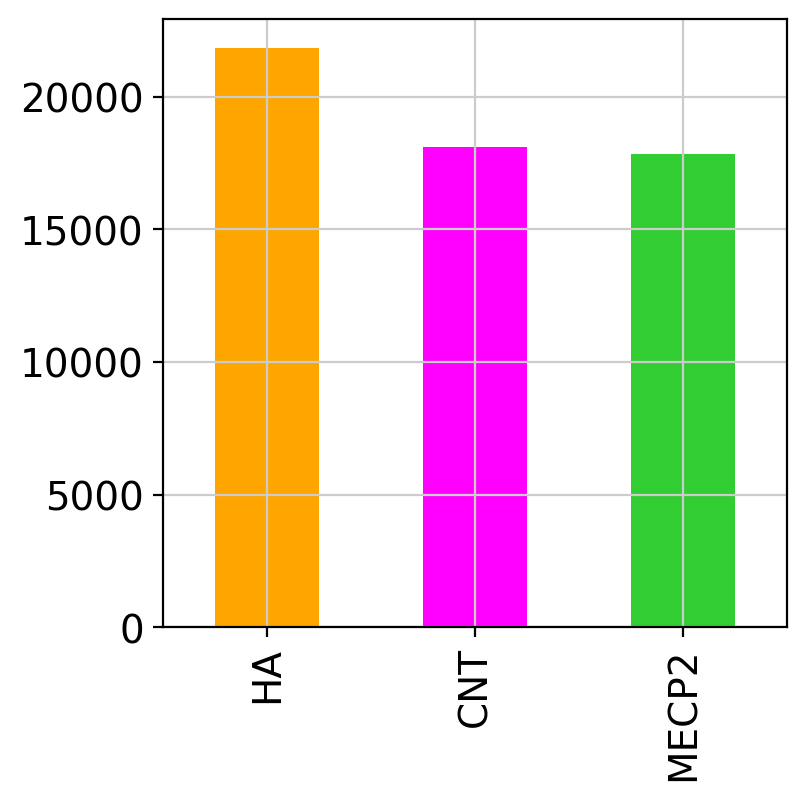

In [22]:
adata.obs['batch_id'].value_counts().plot.bar(color=['orange', 'magenta', 'limegreen'])

In [23]:
adata.obs['sample_id'].value_counts()

Negative    13256
Doublet      9533
CMO309       5192
CMO301       4635
CMO308       3841
CMO302       3747
CMO306       3649
CMO303       3607
CMO307       3525
CMO304       3519
CMO305       3314
Name: sample_id, dtype: int64

In [24]:
adata.obs['sample_id'].value_counts()/adata.obs['sample_id'].value_counts().sum()*100

Negative    22.927116
Doublet     16.487945
CMO309       8.979902
CMO301       8.016535
CMO308       6.643260
CMO302       6.480681
CMO306       6.311183
CMO303       6.238542
CMO307       6.096717
CMO304       6.086340
CMO305       5.731779
Name: sample_id, dtype: float64

<AxesSubplot:>

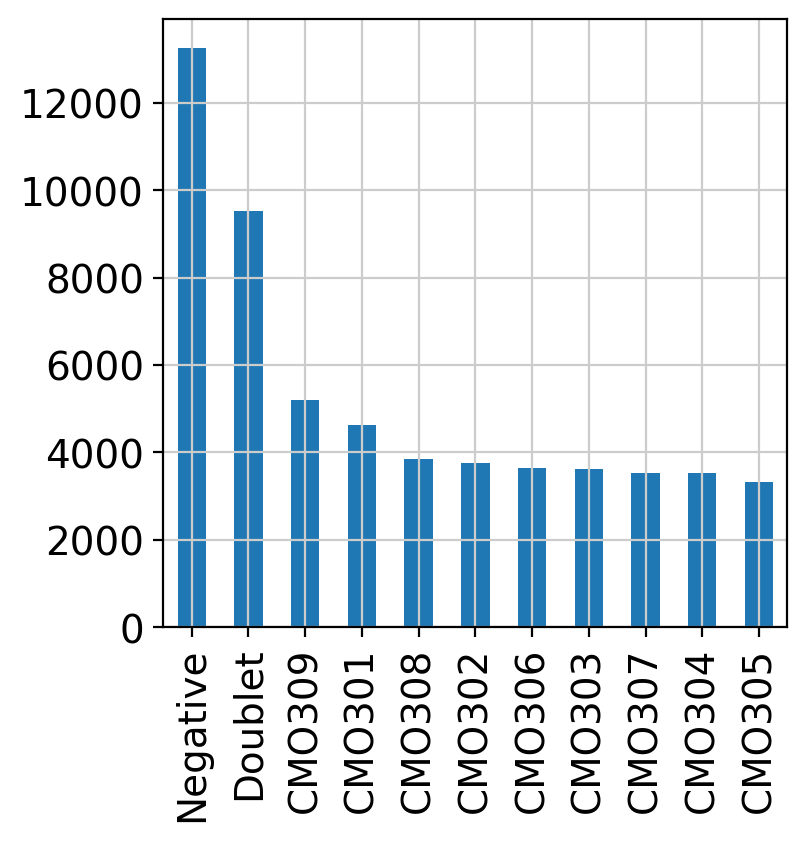

In [25]:
adata.obs['sample_id'].value_counts().plot.bar()

# Quality checks

## Top-Expressed genes

normalizing counts per cell
    finished (0:00:01)


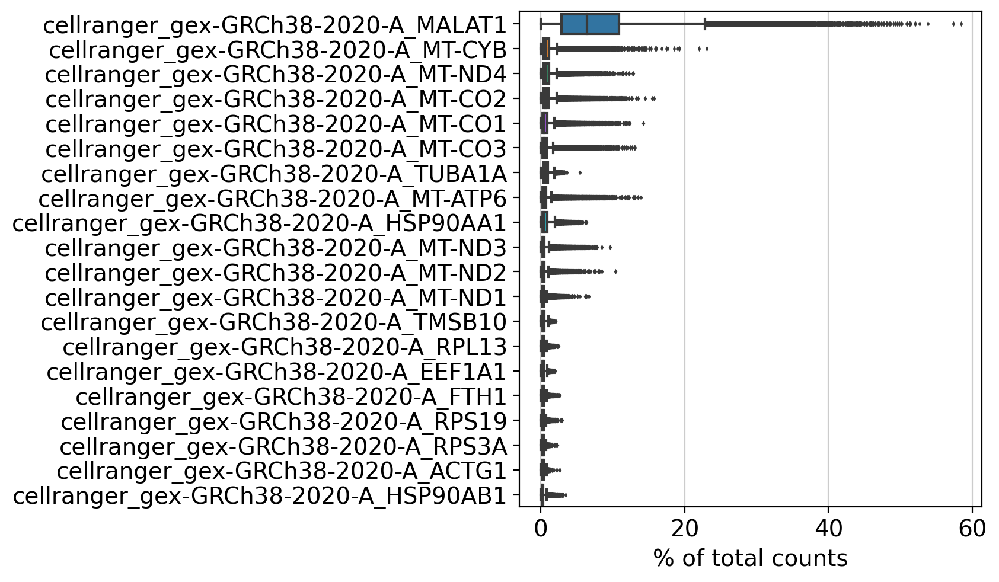

In [26]:
sc.pl.highest_expr_genes(adata, n_top=20)

## Automated QC metrics


**The string based selection is not completely accurate** because it can also include genes that are not mitocondrial/ribosomal but share the string used for the selection. It should be anyway a good enough approximation for our purposes.
*CAREFUL: str.contains must be used with | for the 2 alternatives, cannot be used with the same synthax as startswith with 2 strings.*


In [27]:
#qc_vars wants a column of adata.var containing T/F or 1/0 indicating the genes to be selected for sub-statistics
adata.var['ribo']= adata.var_names.str.contains('^cellranger_gex-GRCh38-2020-A_RPS|^cellranger_gex-GRCh38-2020-A_RPL')
# CAREFUL: str.contains must be used with | for the 2 alternatives, cannot be used with the same synthax as startswith with 2 strings 
#adata.var['rb'] = adata.var_names.str.startswith(("RPS","RPL"))
adata.var['mito']= adata.var_names.str.startswith('cellranger_gex-GRCh38-2020-A_MT-')
adata.var['toxo'] = adata.var_names.str.startswith('ToxoDB_tgondii_ME49_')
adata.var['human'] = adata.var_names.str.startswith('cellranger_gex-GRCh38-2020-A')
adata.var['HA'] = adata.var_names.str.startswith('ToxoDB_tgondii_ME49_mod______HAstop')
adata.var['Mecp2'] = adata.var_names.str.startswith('ToxoDB_tgondii_ME49_mod______MeCP2opt')


In [28]:
#Compute metrics (inplace=True to append to adata)
sc.pp.calculate_qc_metrics(adata, qc_vars=['ribo', 'mito', 'toxo','human','HA','Mecp2'], inplace=True,
                           log1p=False, percent_top=None)
#adata.obs

In [29]:
adata.obs

,batch_id,sample_id,n_genes_by_counts,total_counts,total_counts_ribo,pct_counts_ribo,total_counts_mito,pct_counts_mito,total_counts_toxo,pct_counts_toxo,total_counts_human,pct_counts_human,total_counts_HA,pct_counts_HA,total_counts_Mecp2,pct_counts_Mecp2
AAACCCAAGGAAAGGT-1-CNT,CNT,Doublet,3610,11538.0,1607.0,13.927891,1177.0,10.201075,0.0,0.000000,11538.0,100.000000,0.0,0.0,0.0,0.000000
AAACCCACACAGCCAC-1-CNT,CNT,Doublet,3851,10344.0,1312.0,12.683681,442.0,4.273008,7.0,0.067672,10337.0,99.932327,0.0,0.0,0.0,0.000000
AAACCCACATCATGAC-1-CNT,CNT,CMO303,4553,15033.0,2088.0,13.889444,360.0,2.394732,0.0,0.000000,15033.0,100.000000,0.0,0.0,0.0,0.000000
AAACCCAGTACGTAGG-1-CNT,CNT,CMO303,2675,6512.0,714.0,10.964374,647.0,9.935503,5.0,0.076781,6507.0,99.923218,0.0,0.0,0.0,0.000000
AAACCCAGTAGGACCA-1-CNT,CNT,Doublet,5616,19722.0,2721.0,13.796775,432.0,2.190447,0.0,0.000000,19722.0,100.000000,0.0,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTAGGGTTCATGAGGG-1-MECP2,MECP2,CMO308,1141,4509.0,95.0,2.106897,62.0,1.375028,3952.0,87.646927,557.0,12.353071,0.0,0.0,0.0,0.000000
TTTACGTTCGATGCAT-1-MECP2,MECP2,Negative,1036,2271.0,686.0,30.206957,51.0,2.245707,833.0,36.679874,1438.0,63.320126,0.0,0.0,1.0,0.044033
TTTACTGGTATGCGTT-1-MECP2,MECP2,CMO309,1679,3249.0,454.0,13.973530,132.0,4.062788,5.0,0.153894,3244.0,99.846107,0.0,0.0,0.0,0.000000
TTTCAGTAGCGATGCA-1-MECP2,MECP2,CMO309,718,1152.0,205.0,17.795139,77.0,6.684028,4.0,0.347222,1148.0,99.652779,0.0,0.0,0.0,0.000000


## Inspect quality-related parameters

... storing 'sample_id' as categorical
... storing 'feature_types' as categorical


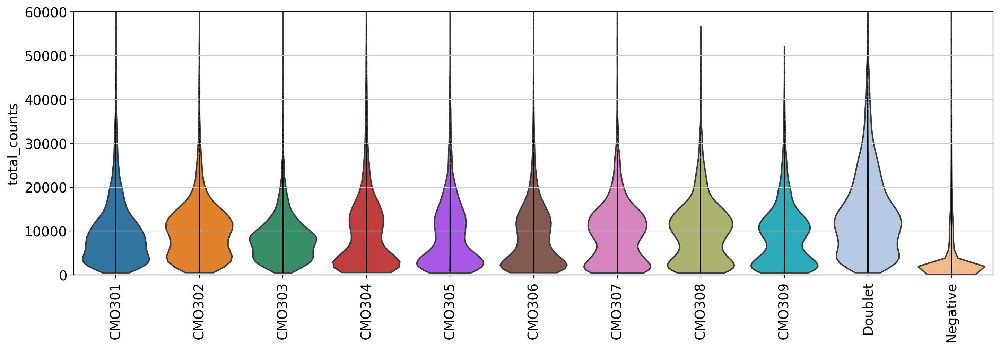

In [30]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 60000)
sc.pl.violin(adata, ['total_counts'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

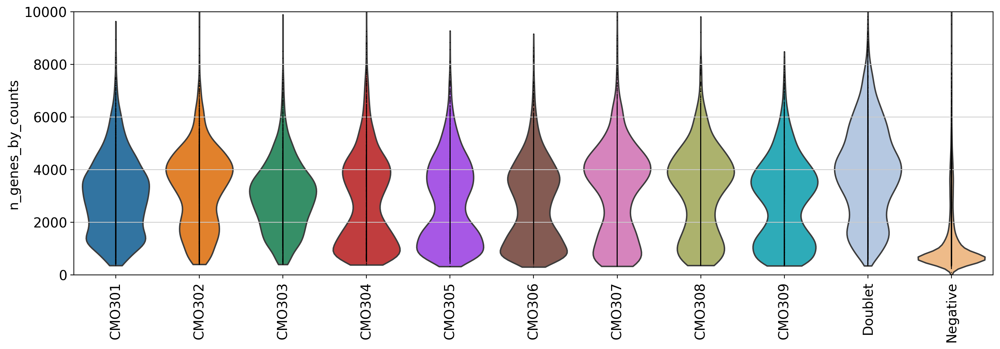

In [31]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 10000)
sc.pl.violin(adata, ['n_genes_by_counts'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)

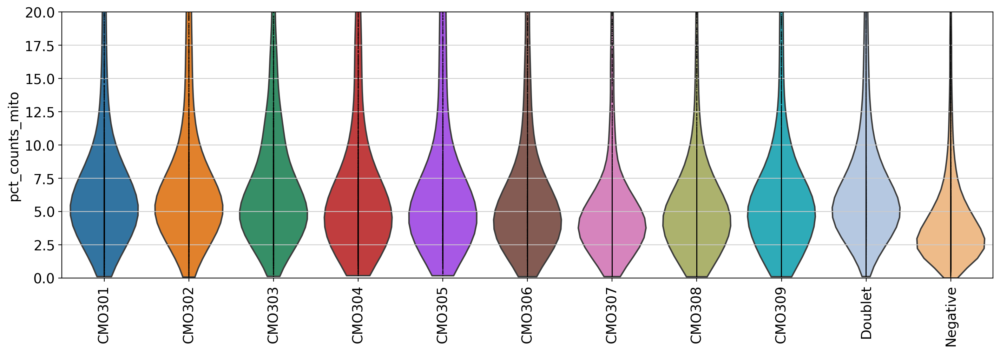

In [32]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 20)
sc.pl.violin(adata, ['pct_counts_mito'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)

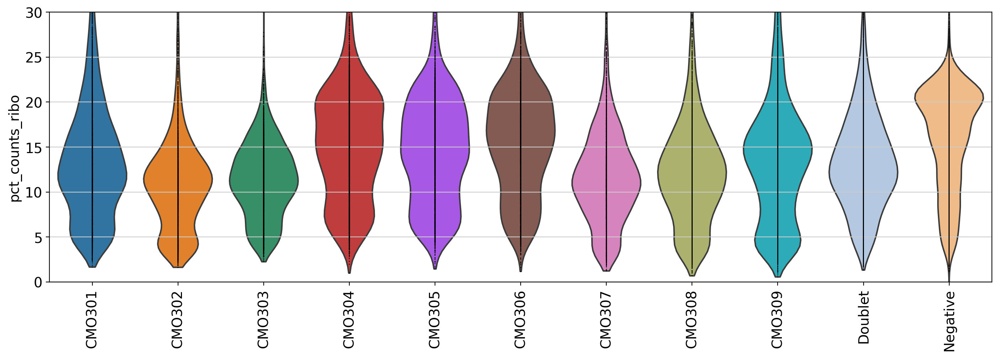

In [33]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 30)
sc.pl.violin(adata, ['pct_counts_ribo'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)

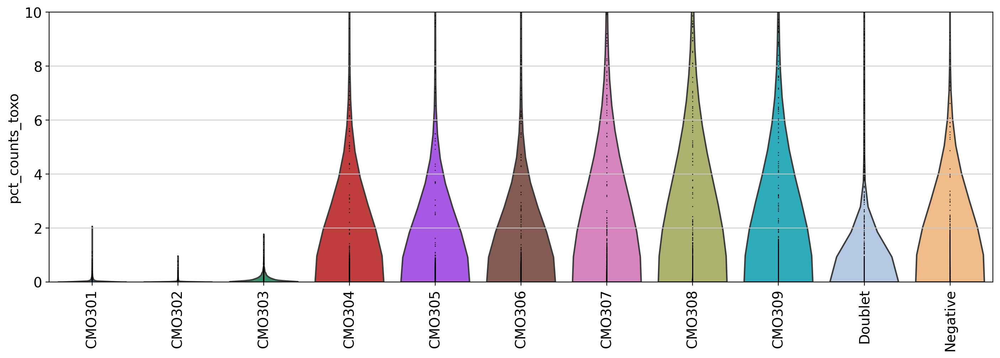

In [34]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 10)
sc.pl.violin(adata, ['pct_counts_toxo'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)

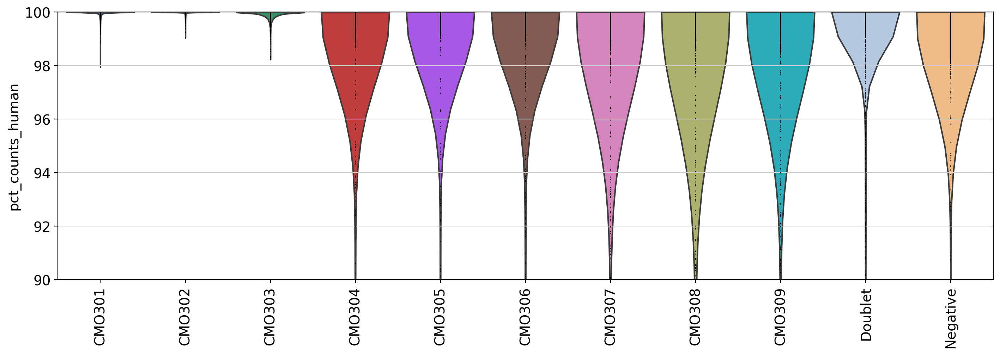

In [35]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(90, 100)
sc.pl.violin(adata, ['pct_counts_human'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)

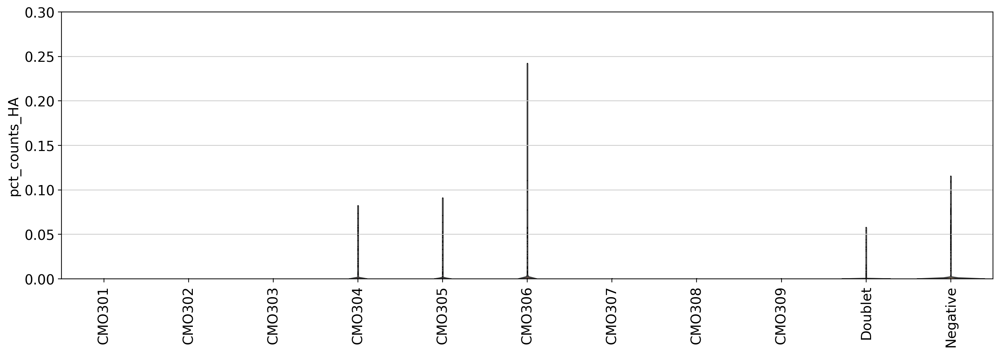

In [36]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 0.3)
sc.pl.violin(adata, ['pct_counts_HA'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., scale="count", ax=ax)

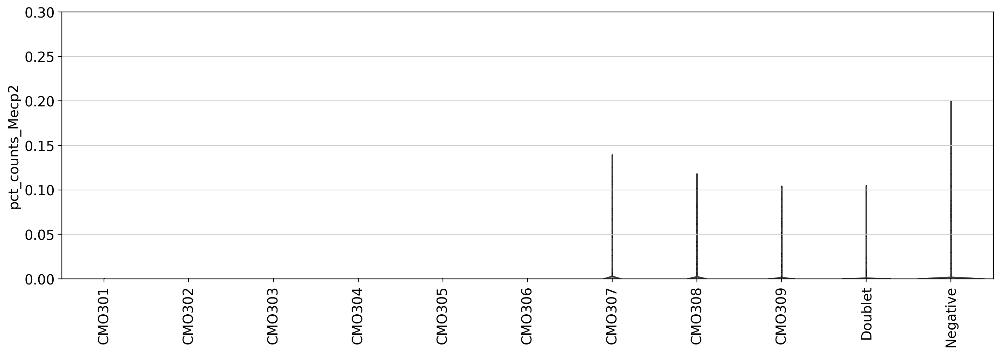

In [37]:
fig, ax = plt.subplots(figsize=(17,5))
ax.set_ylim(0, 0.3)
sc.pl.violin(adata, ['pct_counts_Mecp2'], groupby='sample_id', multi_panel=True, jitter=False, log=False, rotation=90., scale="count", ax=ax)

# Filters

## Filter "doublets" and "negative" cells

In [38]:
adata = adata[~adata.obs["sample_id"].isin(["Doublet", "Negative"])]
adata

View of AnnData object with n_obs × n_vars = 35029 × 45524
    obs: 'batch_id', 'sample_id', 'n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_mito', 'pct_counts_mito', 'total_counts_toxo', 'pct_counts_toxo', 'total_counts_human', 'pct_counts_human', 'total_counts_HA', 'pct_counts_HA', 'total_counts_Mecp2', 'pct_counts_Mecp2'
    var: 'gene_ids', 'feature_types', 'ribo', 'mito', 'toxo', 'human', 'HA', 'Mecp2', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_id_colors'

## Thresholds

In [39]:
MIN_CELLS = 200
#
MIN_GENES = 1000
MAX_GENES = 8000
MIN_COUNTS= 2000
MAX_COUNTS= 30000
#
MT_PERCENTAGE = 15
RIBO_PERCENTAGE = 35
HUMAN_PERCENTAGE = 50

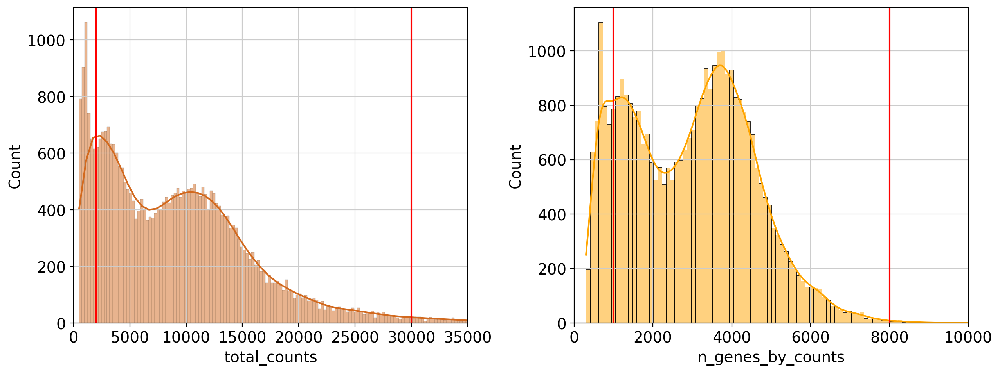

In [40]:
plt.figure(figsize=(13,5), tight_layout=True)

ax1 = plt.subplot(1, 2, 1)
sns.histplot(adata.obs['total_counts'], stat="count", bins=500, color='chocolate', kde=True, ax=ax1)
plt.axvline(MIN_COUNTS, 0, 1, c='red')
plt.axvline(MAX_COUNTS, 0, 1, c='red')
ax1.set_xlim([0., 35000.])

ax2 = plt.subplot(1, 2, 2)
sns.histplot(adata.obs['n_genes_by_counts'], stat="count", bins=100, color='orange', kde=True, ax=ax2)
plt.axvline(MIN_GENES, 0, 1, c='red')
plt.axvline(MAX_GENES, 0, 1, c='red')
ax2.set_xlim([0., 10000.])

plt.show()

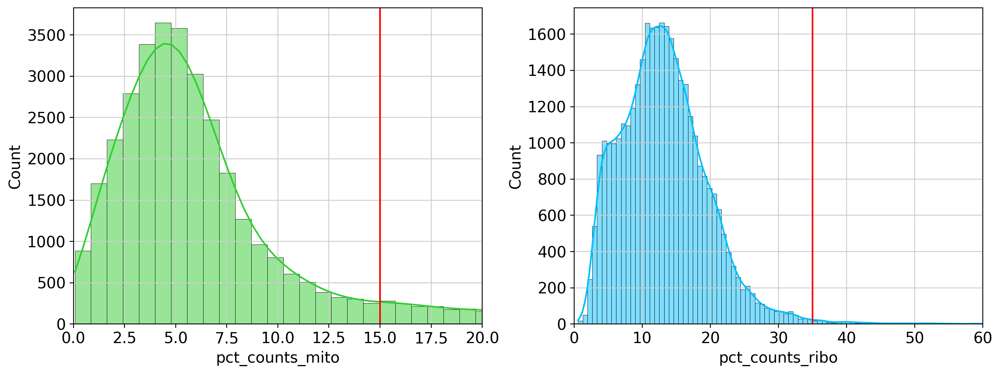

In [41]:
plt.figure(figsize=(13,5), tight_layout=True)

ax1 = plt.subplot(1, 2, 1)
sns.histplot(adata.obs['pct_counts_mito'], stat="count", bins=100, kde=True, color='limegreen', ax=ax1)
plt.axvline(MT_PERCENTAGE, 0, 1, c='red')
ax1.set_xlim([0., 20.])

ax2 = plt.subplot(1, 2, 2)
sns.histplot(adata.obs['pct_counts_ribo'], stat="count", bins=100, kde=True, color='deepskyblue', ax=ax2)
plt.axvline(RIBO_PERCENTAGE, 0, 1, c='red')
ax2.set_xlim([0., 60.])

plt.show()


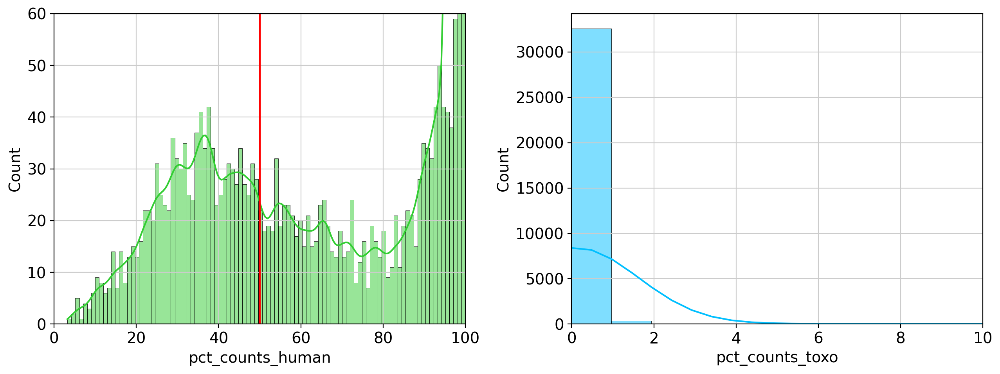

In [42]:
plt.figure(figsize=(13,5), tight_layout=True)

ax1 = plt.subplot(1, 2, 1)
sns.histplot(adata.obs['pct_counts_human'], stat="count", bins=100, kde=True, color='limegreen', ax=ax1)
plt.axvline(HUMAN_PERCENTAGE, 0, 1, c='red')
ax1.set_xlim([0., 100.])
ax1.set_ylim([0., 60.])

ax2 = plt.subplot(1, 2, 2)
sns.histplot(adata.obs['pct_counts_toxo'], stat="count", bins=100, kde=True, color='deepskyblue', ax=ax2)
ax2.set_xlim([0., 10.])

plt.show()

## Filtering cells

### Detected genes

In [43]:
sc.pp.filter_cells(adata, min_genes=MIN_GENES)
print('After filtering on min detected genes:number of cells:', adata.n_obs)
print('After filtering on min detected genes:number of genes:', adata.n_vars)
print()

filtered out 4586 cells that have less than 1000 genes expressed


Trying to set attribute `.obs` of view, copying.


After filtering on min detected genes:number of cells: 30443
After filtering on min detected genes:number of genes: 45524



In [44]:
sc.pp.filter_cells(adata, max_genes=MAX_GENES)
print('After filtering on max detected genes:number of cells:', adata.n_obs)
print('After filtering on max detected genes:number of genes:', adata.n_vars)


filtered out 63 cells that have more than 8000 genes expressed
After filtering on max detected genes:number of cells: 30380
After filtering on max detected genes:number of genes: 45524


### UMI counts

In [45]:
sc.pp.filter_cells(adata, min_counts=MIN_COUNTS)
print('After filtering on min UMI counts:number of cells:', adata.n_obs)
print('After filtering on min UMI counts:number of genes:', adata.n_vars)
print()

filtered out 529 cells that have less than 2000 counts
After filtering on min UMI counts:number of cells: 29851
After filtering on min UMI counts:number of genes: 45524



In [46]:
sc.pp.filter_cells(adata, max_counts=MAX_COUNTS)
print('After filtering on min UMI counts:number of cells:', adata.n_obs)
print('After filtering on min UMI counts:number of genes:', adata.n_vars)
print()

filtered out 586 cells that have more than 30000 counts
After filtering on min UMI counts:number of cells: 29265
After filtering on min UMI counts:number of genes: 45524



### Mitochondrial RNA

In [47]:
adata = adata[adata.obs['pct_counts_mito'] < MT_PERCENTAGE, :]

print('After filtering on mitochondrial RNA: number of cells:', adata.n_obs)

After filtering on mitochondrial RNA: number of cells: 25955


### Ribosomal RNA

In [48]:
adata = adata[adata.obs['pct_counts_ribo'] < RIBO_PERCENTAGE, :]

print('After filtering on ribosomal protein RNA: number of cells:', adata.n_obs)

After filtering on ribosomal protein RNA: number of cells: 25765


###  Human genes percentage 

In [49]:
adata = adata[adata.obs['pct_counts_human'] > HUMAN_PERCENTAGE, :]

print('After filtering on only human genes: number of cells:', adata.n_obs)

After filtering on only human genes: number of cells: 25321


## Filtering genes

We implement a manual filtering so that beyond the genes respecting the threhsold also our genes of interest from the constructs are kept. 


In [50]:
print('Before gene filtering: number of genes:', adata.n_vars)
print('Before gene filtering: number of cells:', adata.n_obs)

Before gene filtering: number of genes: 45524
Before gene filtering: number of cells: 25321


In [51]:
keep = sc.pp.filter_genes(adata, min_cells=MIN_CELLS, inplace=False)

keep[0][-1] = True
keep[0][-2] = True
keep[0][-3] = True

adata = adata[:, keep[0]]

filtered out 28753 genes that are detected in less than 200 cells


In [52]:
adata.var_names

Index(['cellranger_gex-GRCh38-2020-A_AL627309.5',
       'cellranger_gex-GRCh38-2020-A_LINC01409',
       'cellranger_gex-GRCh38-2020-A_LINC01128',
       'cellranger_gex-GRCh38-2020-A_LINC00115',
       'cellranger_gex-GRCh38-2020-A_FAM41C',
       'cellranger_gex-GRCh38-2020-A_AL645608.6',
       'cellranger_gex-GRCh38-2020-A_AL645608.2',
       'cellranger_gex-GRCh38-2020-A_SAMD11',
       'cellranger_gex-GRCh38-2020-A_NOC2L',
       'cellranger_gex-GRCh38-2020-A_KLHL17',
       ...
       'ToxoDB_tgondii_ME49_mod______TGME49_295110',
       'ToxoDB_tgondii_ME49_mod______TGME49_295935',
       'ToxoDB_tgondii_ME49_mod______TGME49_295360',
       'ToxoDB_tgondii_ME49_mod______TGME49_295350',
       'ToxoDB_tgondii_ME49_mod______TGME49_322800',
       'ToxoDB_tgondii_ME49_mod______TGME49_255060',
       'ToxoDB_tgondii_ME49_mod______TGME49_330000',
       'ToxoDB_tgondii_ME49_mod______GRA16',
       'ToxoDB_tgondii_ME49_mod______HAstop',
       'ToxoDB_tgondii_ME49_mod______MeCP2opt']

In [53]:
print('After gene filtering: number of genes:', adata.n_vars)
print('After filtering: number of cells:', adata.n_obs)

After gene filtering: number of genes: 16774
After filtering: number of cells: 25321


# Numbers and Visualization after filtering

In [54]:
print('After applied filtering: number of cells:', adata.n_obs)
print('After applied filtering: number of genes:', adata.n_vars)

After applied filtering: number of cells: 25321
After applied filtering: number of genes: 16774


## Violin plots


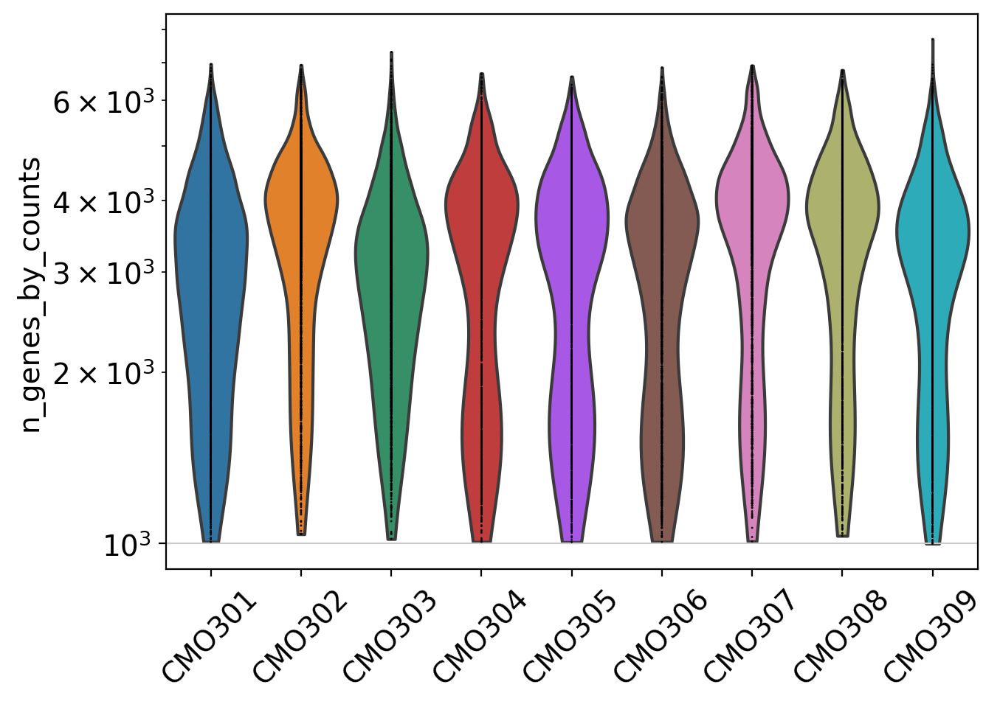

In [55]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['n_genes_by_counts'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=True, ax=ax)

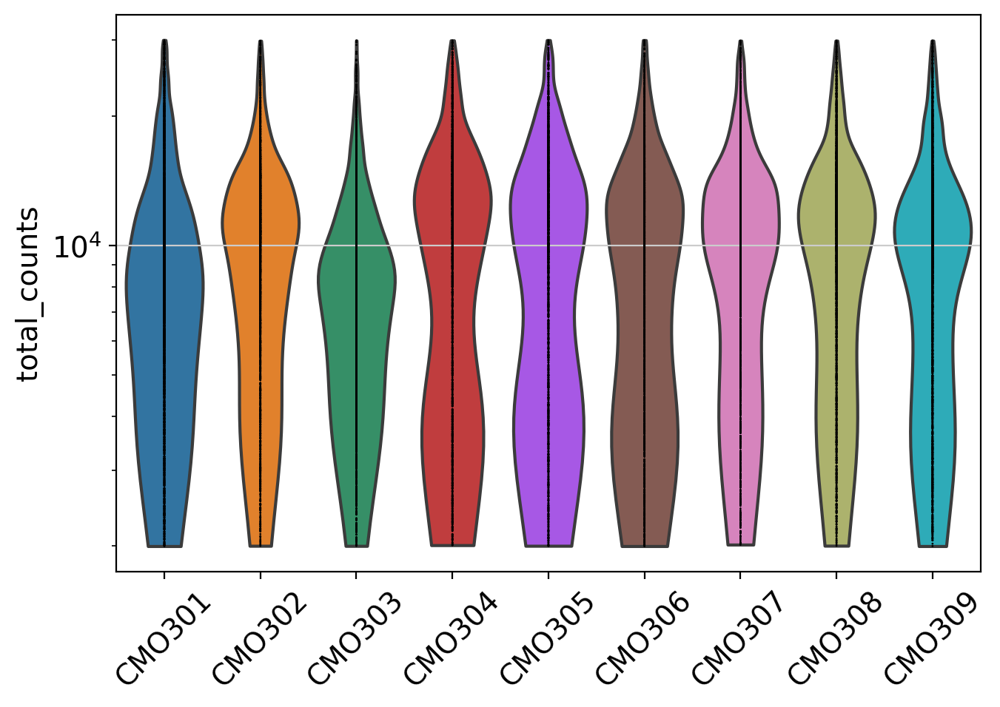

In [56]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['total_counts'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=True, ax=ax)

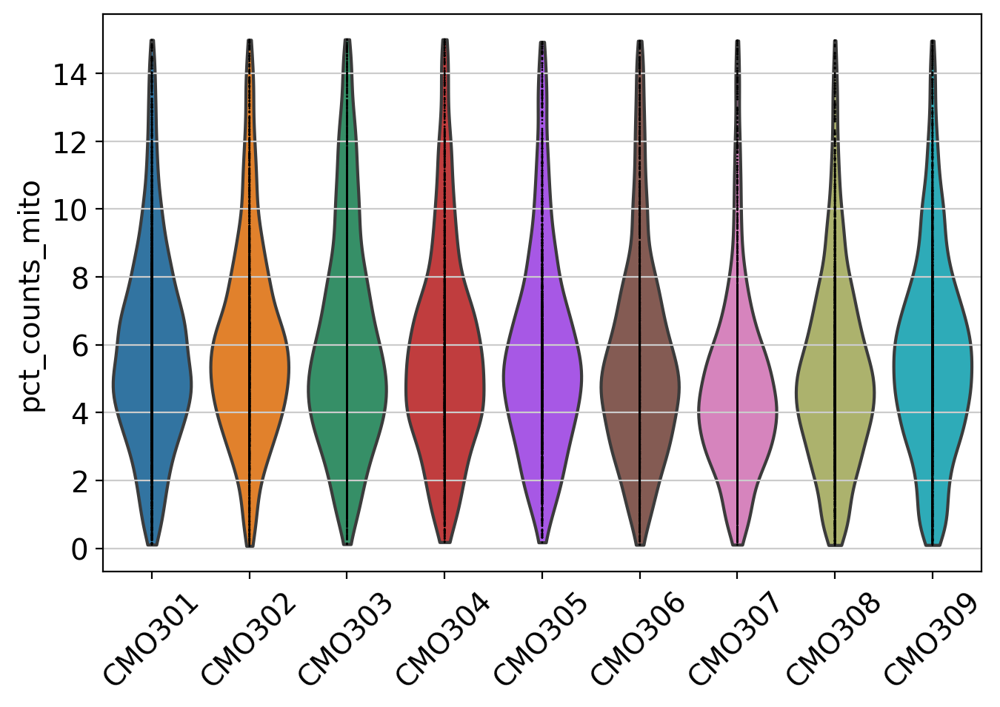

In [57]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['pct_counts_mito'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=False, ax=ax)

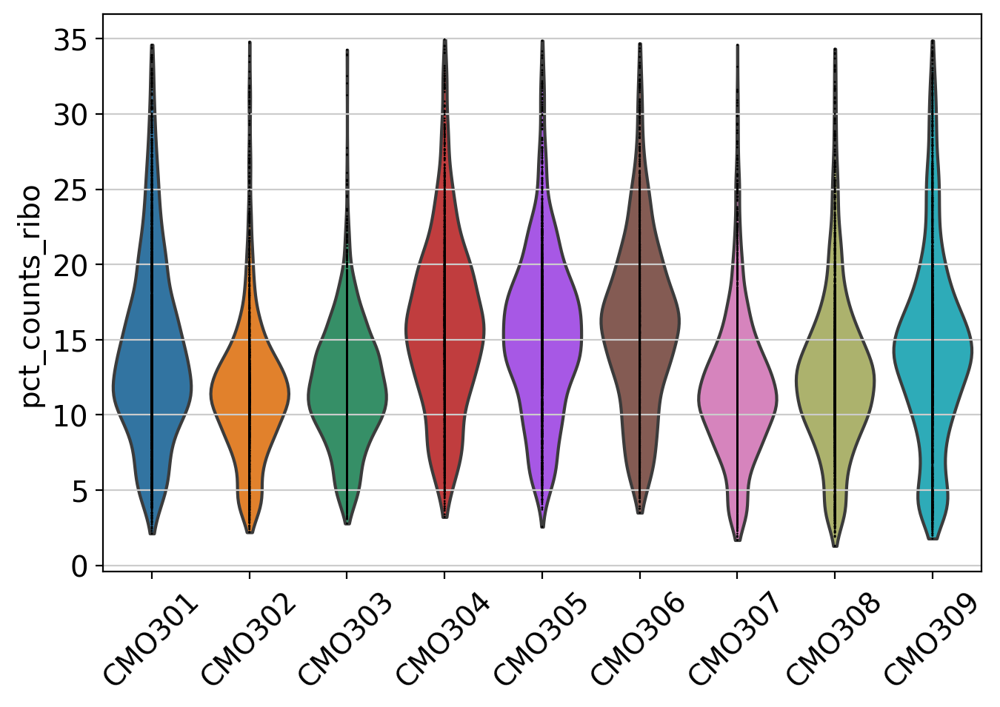

In [58]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['pct_counts_ribo'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=False, ax=ax)

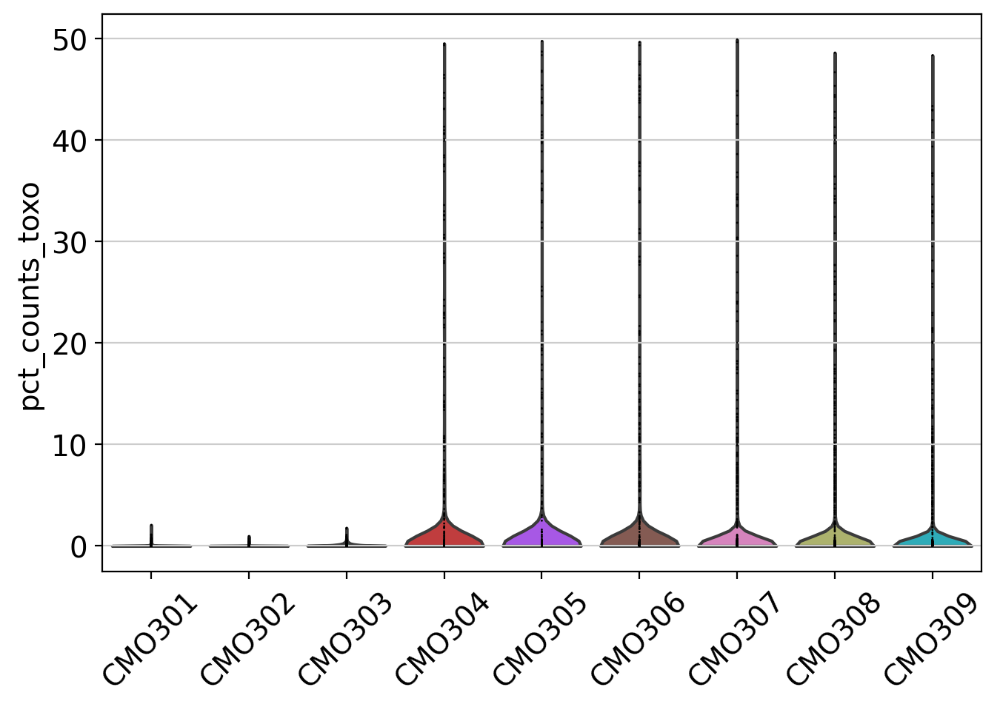

In [59]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['pct_counts_toxo'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=False, ax=ax)

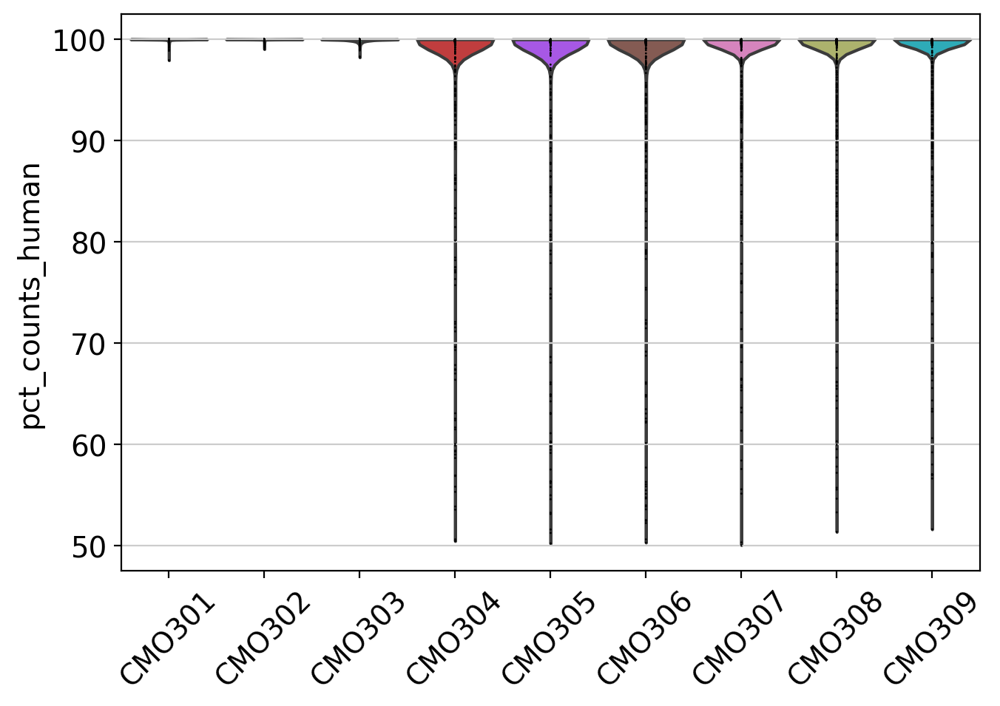

In [60]:
fig, ax = plt.subplots(figsize=(7,5), tight_layout=True)

sc.pl.violin(adata, keys=['pct_counts_human'],
              multi_panel=True, groupby='sample_id', rotation=45, jitter=False, log=False, ax=ax)

## Density plots

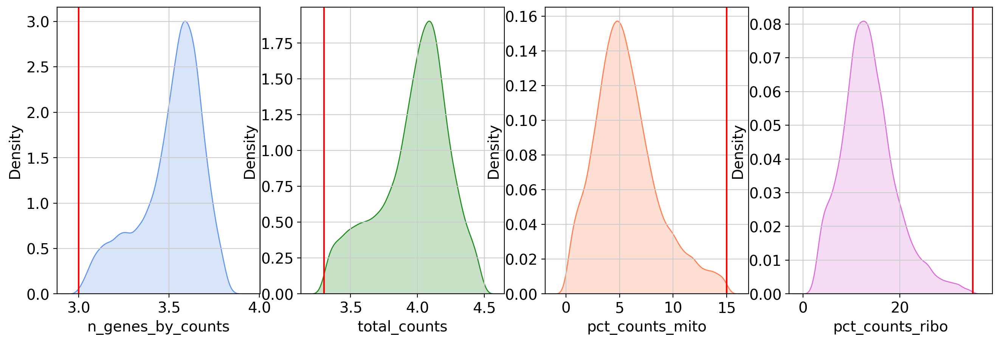

In [61]:
#Plot them in line so they take up less space
plt.figure(figsize=(20,5))

plt.subplot(1, 5, 1)
sns.kdeplot(np.log10(adata.obs['n_genes_by_counts']), shade=True, color='cornflowerblue')
plt.axvline(np.log10(MIN_GENES), 0, 1, c='red')  #set manually for chosen threshold

plt.subplot(1, 5, 2)
sns.kdeplot(np.log10(adata.obs['total_counts']), shade=True, color='forestgreen')
plt.axvline(np.log10(MIN_COUNTS), 0, 1, c='red')  #set manually for chosen threshold

plt.subplot(1, 5, 3)
sns.kdeplot(adata.obs['pct_counts_mito'], shade=True, color='coral')
plt.axvline(MT_PERCENTAGE, 0, 1, c='red')  #set manually for chosen threshold

plt.subplot(1, 5, 4)
sns.kdeplot(adata.obs['pct_counts_ribo'], shade=True, color='orchid')
plt.axvline(RIBO_PERCENTAGE, 0, 1, c='red')  #set manually for chosen threshold

## batches and IDs

<AxesSubplot:>

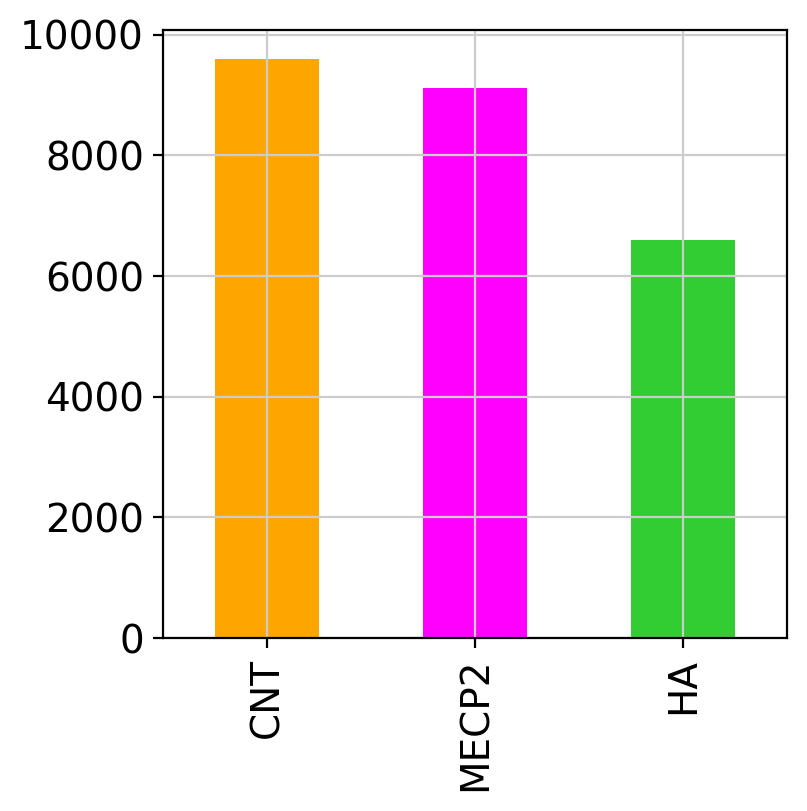

In [62]:
adata.obs['batch_id'].value_counts().plot.bar(color=['orange', 'magenta', 'limegreen'])

<AxesSubplot:>

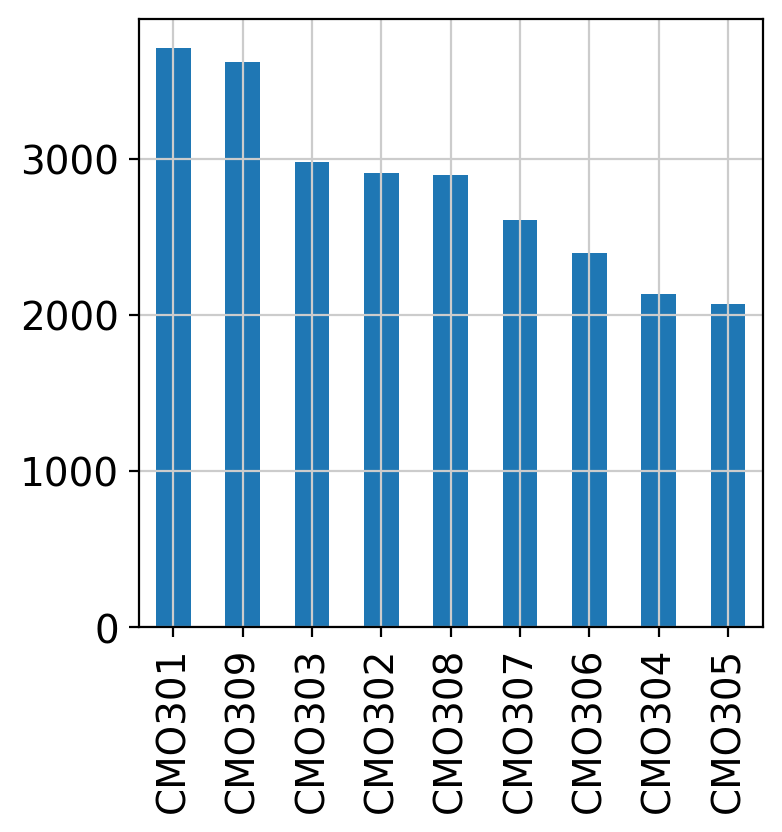

In [63]:
adata.obs['sample_id'].value_counts().plot.bar()

# Dimensionality reduction and annotation of the full dataset

## Normalize and Log-transform
For this quick exploration I adopt the basic normalization from scanpy

In [64]:
adata.layers["counts"] = adata.X.copy()

In [65]:
sc.pp.normalize_total(adata, exclude_highly_expressed=True)
sc.pp.log1p(adata)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['cellranger_gex-GRCh38-2020-A_HSPA1A', 'cellranger_gex-GRCh38-2020-A_ANGPT2', 'cellranger_gex-GRCh38-2020-A_MALAT1', 'cellranger_gex-GRCh38-2020-A_HSP90AA1', 'cellranger_gex-GRCh38-2020-A_PLCG2', 'cellranger_gex-GRCh38-2020-A_AC010319.3', 'cellranger_gex-GRCh38-2020-A_FTL', 'cellranger_gex-GRCh38-2020-A_NNAT', 'cellranger_gex-GRCh38-2020-A_MT-ND4', 'cellranger_gex-GRCh38-2020-A_MT-CYB']
    finished (0:00:00)


## Triku gene selection

In [66]:
sc.pp.pca(adata)
sc.pp.neighbors(adata, metric='cosine', n_neighbors=int(0.5 * len(adata) ** 0.5))

computing PCA
    with n_comps=50
    finished (0:00:38)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)


In [67]:
tk.tl.triku(adata, use_raw=False)

In [68]:
Top20Triku = adata.var.sort_values(by=['triku_distance'], ascending=False).head(20).index
Top20Triku

Index(['ToxoDB_tgondii_ME49_mod______TGME49_231140',
       'ToxoDB_tgondii_ME49_mod______TGME49_300000',
       'ToxoDB_tgondii_ME49_mod______TGME49_291850',
       'ToxoDB_tgondii_ME49_mod______TGME49_217890',
       'ToxoDB_tgondii_ME49_mod______TGME49_205558',
       'ToxoDB_tgondii_ME49_mod______TGME49_226570',
       'ToxoDB_tgondii_ME49_mod______TGME49_263700',
       'ToxoDB_tgondii_ME49_mod______TGME49_309120',
       'ToxoDB_tgondii_ME49_mod______TGME49_257090',
       'ToxoDB_tgondii_ME49_mod______TGME49_251680',
       'ToxoDB_tgondii_ME49_mod______TGME49_257350',
       'ToxoDB_tgondii_ME49_mod______TGME49_290700',
       'ToxoDB_tgondii_ME49_mod______TGME49_239760',
       'ToxoDB_tgondii_ME49_mod______TGME49_249720',
       'ToxoDB_tgondii_ME49_mod______TGME49_273760',
       'ToxoDB_tgondii_ME49_mod______TGME49_462890',
       'ToxoDB_tgondii_ME49_mod______TGME49_276940',
       'ToxoDB_tgondii_ME49_mod______TGME49_226410',
       'ToxoDB_tgondii_ME49_mod______TGME49_26

In [69]:
print('Number of Higly Variable Genes', len(adata.var_names[adata.var['highly_variable'] == True])) ##numero HVG

Number of Higly Variable Genes 1771


## PCA

In [70]:
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:03)


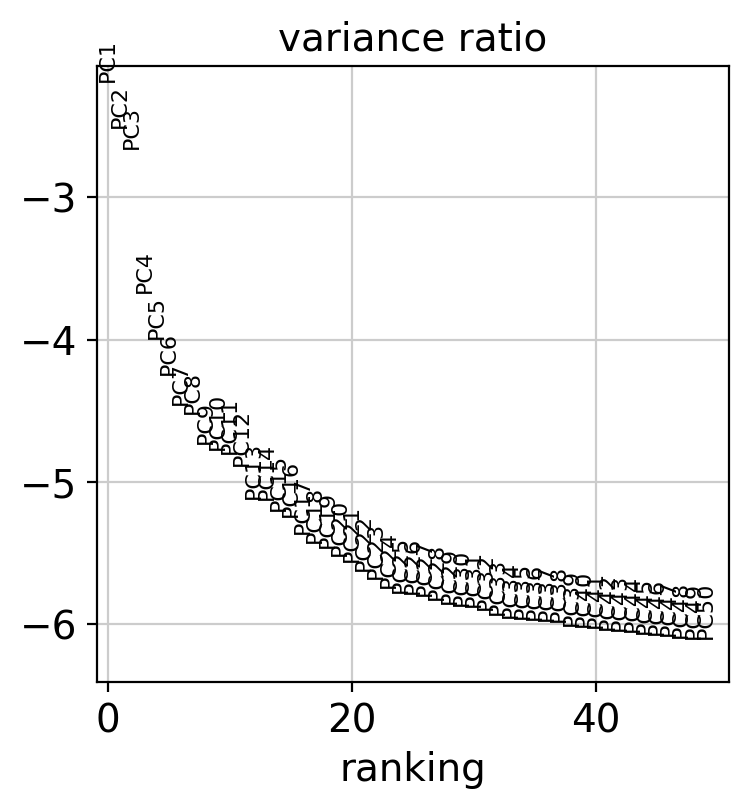

In [71]:
sc.pl.pca_variance_ratio(adata, log=True, n_pcs=50)

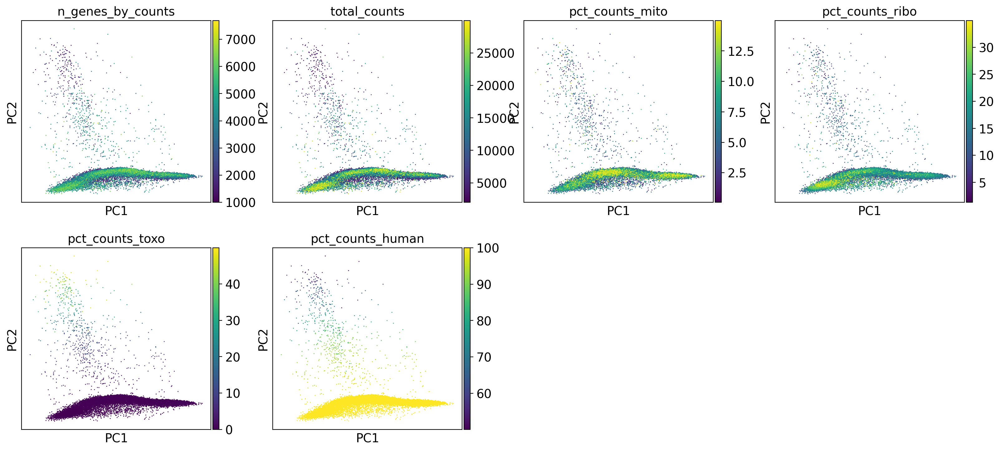

In [72]:
sc.pl.pca(adata, color=['n_genes_by_counts', 'total_counts', 'pct_counts_mito', 'pct_counts_ribo', 'pct_counts_toxo', 'pct_counts_human'])

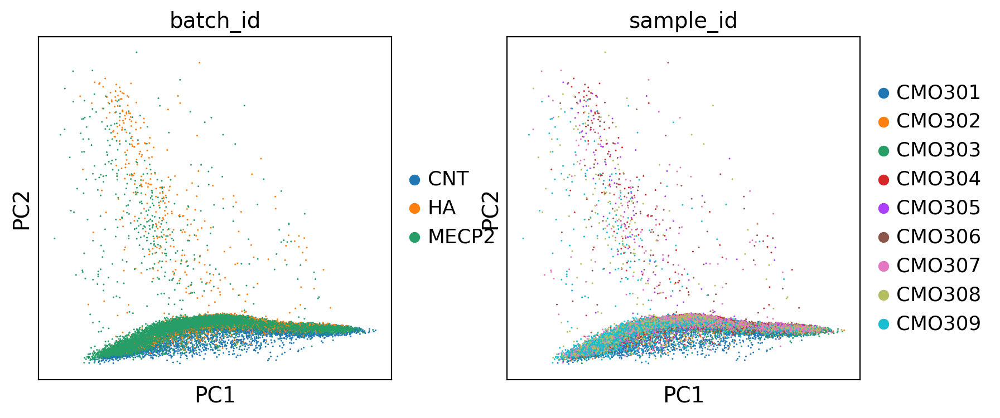

In [73]:
sc.pl.pca(adata, color=['batch_id', 'sample_id'])

## UMAP

In [74]:
sc.pp.neighbors(adata, n_neighbors=80, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:27)


In [75]:
sc.tl.umap(adata, random_state=1)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)


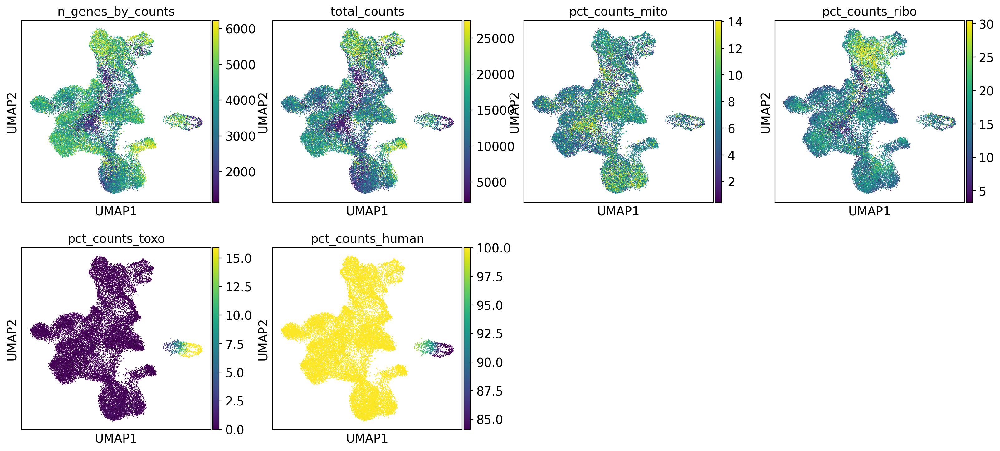

In [76]:
sc.pl.umap(adata, color=['n_genes_by_counts', 'total_counts', 'pct_counts_mito', 'pct_counts_ribo', 'pct_counts_toxo', 'pct_counts_human'], vmin='p1', vmax='p99')

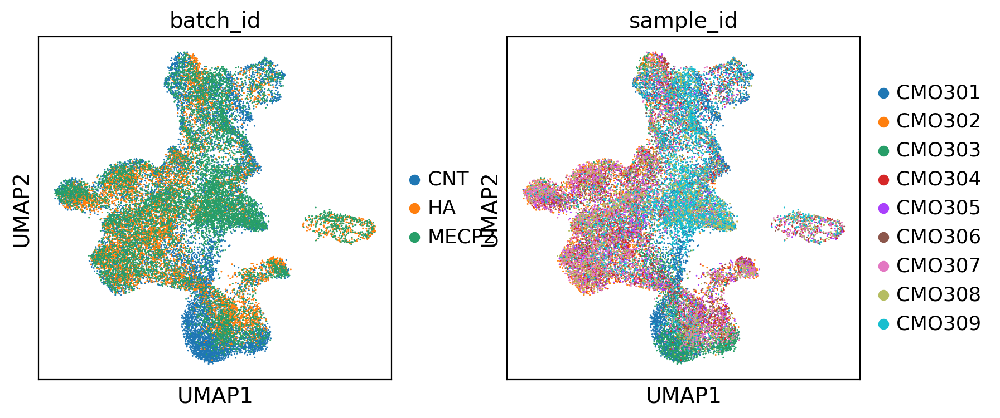

In [77]:
sc.pl.umap(adata, color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')

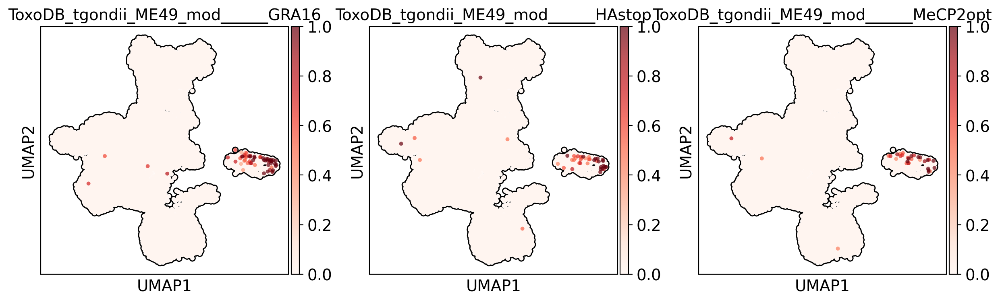

In [78]:
sc.pl.umap(adata, color=['ToxoDB_tgondii_ME49_mod______GRA16',
                         'ToxoDB_tgondii_ME49_mod______HAstop',
                         'ToxoDB_tgondii_ME49_mod______MeCP2opt'],
           size=50, cmap="Reds", add_outline=True, vmax=1)

computing density on 'umap'
--> added
    'umap_density_batch_id', densities (adata.obs)
    'umap_density_batch_id_params', parameter (adata.uns)


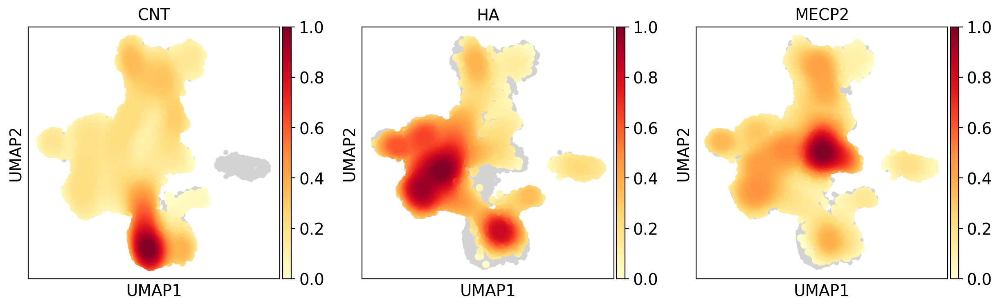

In [79]:
sc.tl.embedding_density(adata, groupby='batch_id')
sc.pl.embedding_density(adata, groupby='batch_id')

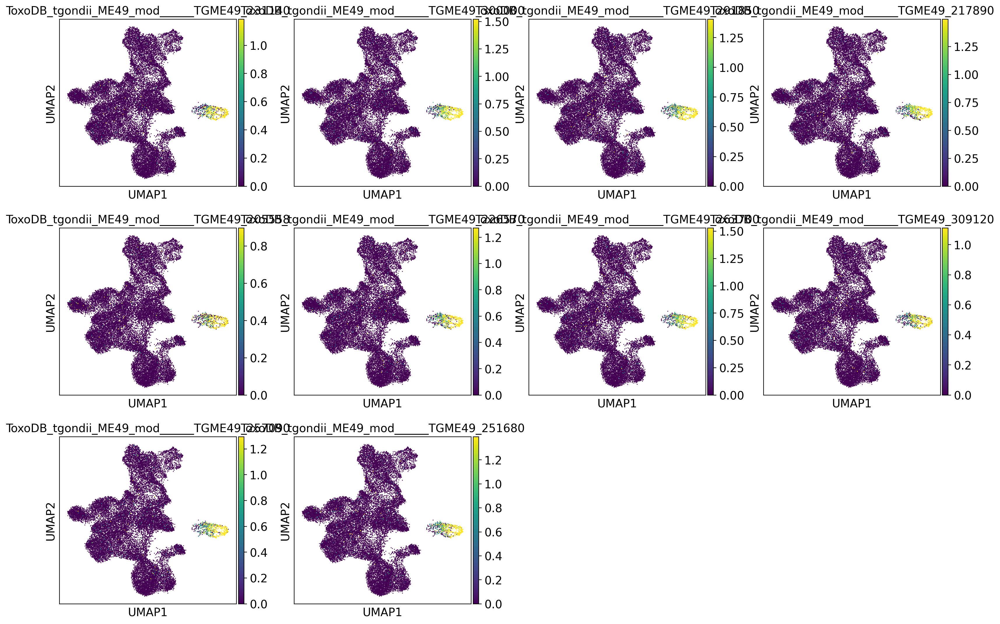

In [80]:
Top10Triku = adata.var.sort_values(by=['triku_distance'], ascending=False).head(10).index
sc.pl.umap(adata, color=Top10Triku, vmin='p1', vmax='p99')

## Cluster identification

In [81]:
res = [0.3, 0.4, 0.5, 0.6]
leiden_labels = []

for x in res:
    label = "Leiden_" + str(x).replace('.', '')
    leiden_labels.append(label) 
    sc.tl.leiden(adata, resolution = x, key_added= label)

running Leiden clustering
    finished: found 7 clusters and added
    'Leiden_03', the cluster labels (adata.obs, categorical) (0:00:14)
running Leiden clustering
    finished: found 9 clusters and added
    'Leiden_04', the cluster labels (adata.obs, categorical) (0:00:12)
running Leiden clustering
    finished: found 9 clusters and added
    'Leiden_05', the cluster labels (adata.obs, categorical) (0:00:12)
running Leiden clustering
    finished: found 11 clusters and added
    'Leiden_06', the cluster labels (adata.obs, categorical) (0:00:17)


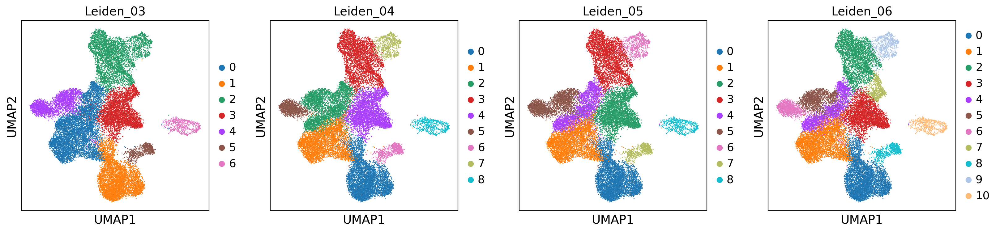

In [82]:
sc.pl.umap(adata, color=leiden_labels)

## *bona-fide* infected cells

In [83]:
adata.obs["infected"] = (adata.obs['Leiden_03'] == "6").astype(str)

In [84]:
adata.obs["batch_infect"] = adata.obs["batch_id"].astype(str) + "_" + adata.obs["infected"].map({"True": "infect", "False": "not_infect"}).astype(str)

... storing 'infected' as categorical
... storing 'batch_infect' as categorical


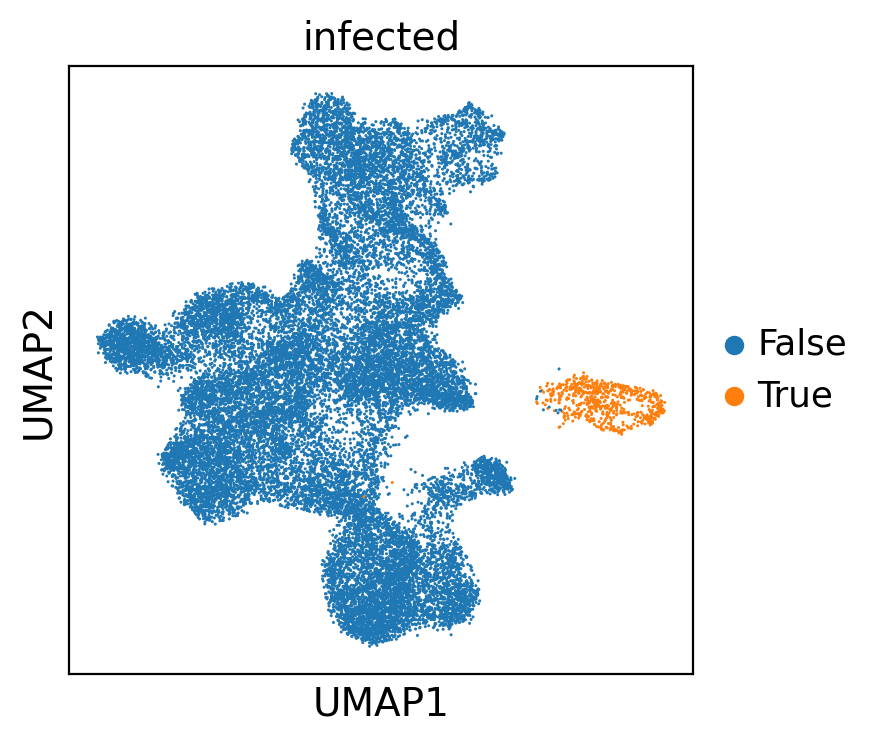

In [85]:
sc.pl.umap(adata, color="infected")

In [86]:
cell_numbers = pd.crosstab(adata.obs["batch_id"], adata.obs["infected"])
cell_numbers

infected,False,True
batch_id,,
CNT,9599,0
HA,6313,285
MECP2,8775,349


In [87]:
cell_frac = pd.crosstab(adata.obs["batch_id"], adata.obs["infected"], normalize="index")
cell_frac

infected,False,True
batch_id,,
CNT,1.000000,0.000000
HA,0.956805,0.043195
MECP2,0.961749,0.038251


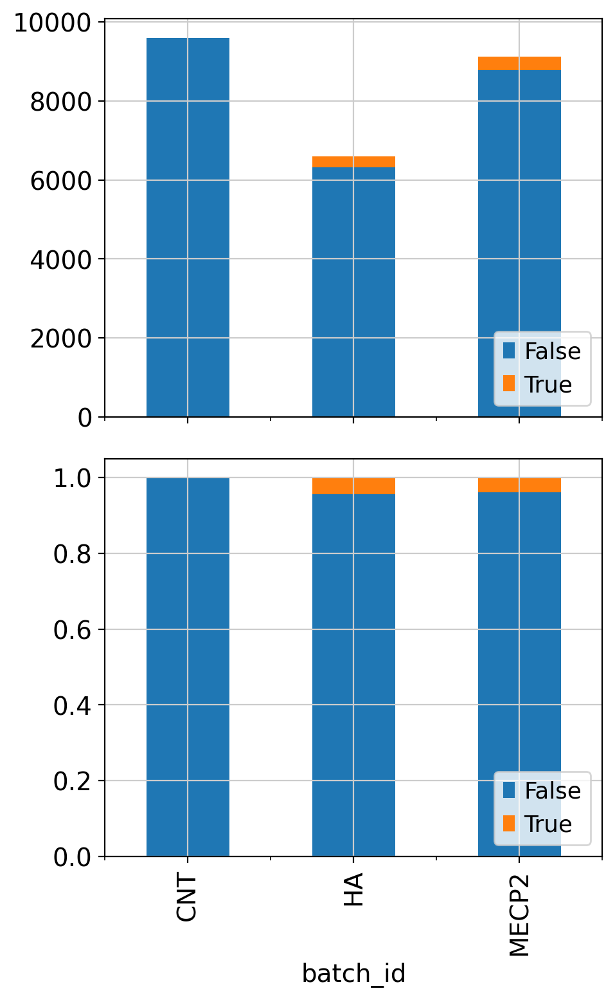

In [88]:
fig1, [ax1, ax2] = plt.subplots(ncols=1, nrows=2, figsize=(5, 8), sharex=True)
cell_numbers.plot.bar(stacked=True, ax=ax1).legend(loc='lower right')
cell_frac.plot.bar(stacked=True, ax=ax2).legend(loc='lower right')
fig1.tight_layout()
fig1.show()

In [89]:
cell_numbers = pd.crosstab(adata.obs["sample_id"], adata.obs["infected"])
cell_numbers

infected,False,True
sample_id,,
CMO301,3710,0
CMO302,2909,0
CMO303,2980,0
CMO304,2038,93
CMO305,1989,82
CMO306,2286,110
CMO307,2504,101
CMO308,2781,117
CMO309,3490,131


In [90]:
cell_frac = pd.crosstab(adata.obs["sample_id"], adata.obs["infected"], normalize="index")
cell_frac

infected,False,True
sample_id,,
CMO301,1.000000,0.000000
CMO302,1.000000,0.000000
CMO303,1.000000,0.000000
CMO304,0.956359,0.043641
CMO305,0.960406,0.039594
CMO306,0.954090,0.045910
CMO307,0.961228,0.038772
CMO308,0.959627,0.040373
CMO309,0.963822,0.036178


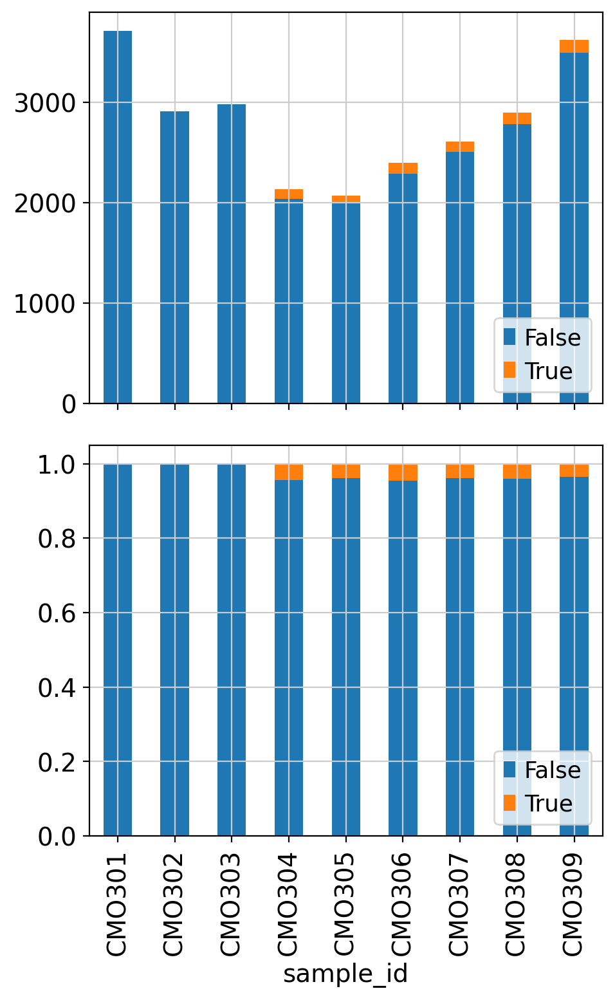

In [91]:
fig1, [ax1, ax2] = plt.subplots(ncols=1, nrows=2, figsize=(5, 8), sharex=True)
cell_numbers.plot.bar(stacked=True, ax=ax1).legend(loc='lower right')
cell_frac.plot.bar(stacked=True, ax=ax2).legend(loc='lower right')
fig1.tight_layout()
fig1.show()

## Diffusion map

In [92]:
sc.tl.diffmap(adata)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99113905 0.9894013  0.98666364 0.9756393  0.9732643
     0.9695597  0.9625886  0.9538792  0.9430543  0.9418772  0.9359208
     0.9291804  0.9224625  0.92067695]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:01)


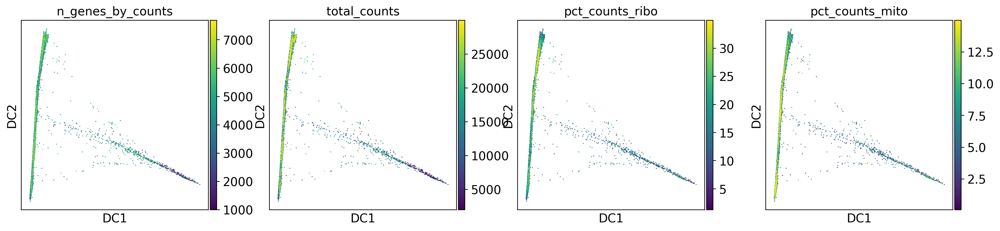

In [93]:
sc.pl.diffmap(adata, color=['n_genes_by_counts', 'total_counts', 'pct_counts_ribo', 'pct_counts_mito'])

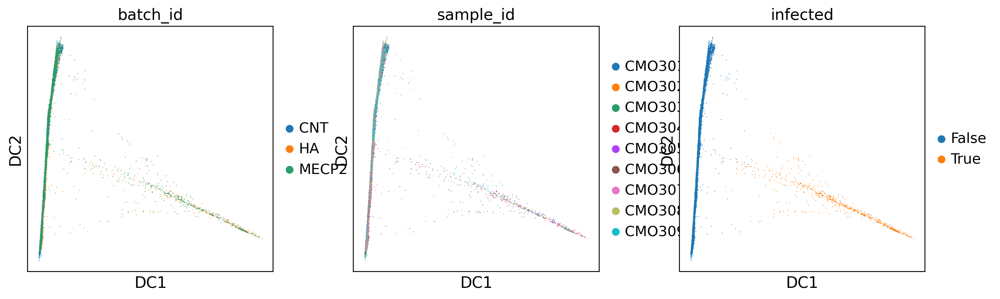

In [94]:
sc.pl.diffmap(adata, color=['batch_id', 'sample_id', 'infected'], size=2)

## Draw graph

In [95]:
sc.tl.draw_graph(adata)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:04:22)


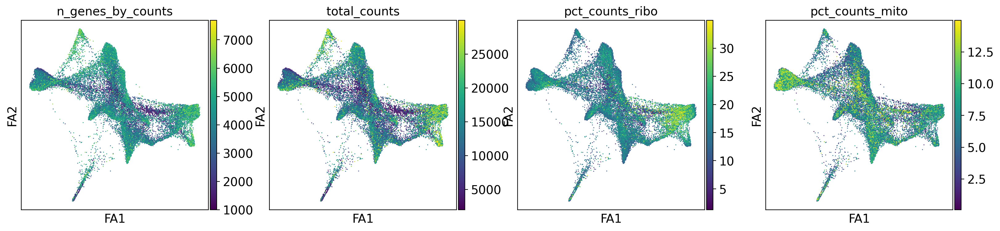

In [96]:
sc.pl.draw_graph(adata, color=['n_genes_by_counts', 'total_counts', 'pct_counts_ribo', 'pct_counts_mito'])

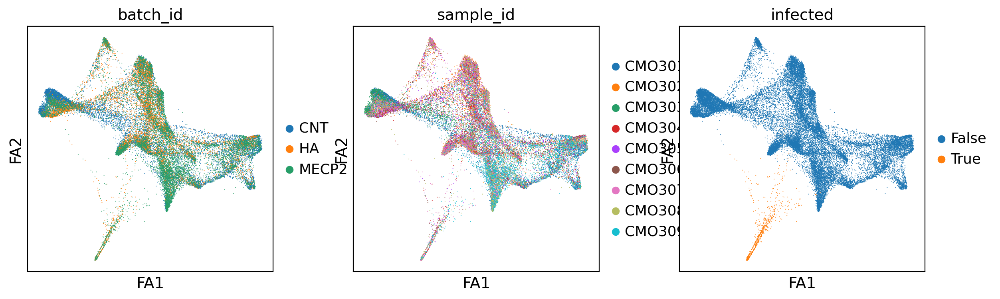

In [97]:
sc.pl.draw_graph(adata, color=['batch_id', 'sample_id', 'infected'], size=2)

## Marker plots

**the marker plots are collected in the notebook "02-markers.ipynb"**

# Dimensionality reduction and annotation of the human-only dataset

## human genes only - recover raw counts

In [98]:
onlyhuman = sc.AnnData(
    obs=adata[:, adata.var_names.str.startswith('cellranger_gex-GRCh38-2020-A')].obs.copy(),
    var=adata[:, adata.var_names.str.startswith('cellranger_gex-GRCh38-2020-A')].var.copy(),
    X=adata[:, adata.var_names.str.startswith('cellranger_gex-GRCh38-2020-A')].layers["counts"]
)

In [99]:
onlyhuman.var.index = onlyhuman.var.index.str.replace("cellranger_gex-GRCh38-2020-A_", "")

In [100]:
onlyhuman

AnnData object with n_obs × n_vars = 25321 × 16240
    obs: 'batch_id', 'sample_id', 'n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_mito', 'pct_counts_mito', 'total_counts_toxo', 'pct_counts_toxo', 'total_counts_human', 'pct_counts_human', 'total_counts_HA', 'pct_counts_HA', 'total_counts_Mecp2', 'pct_counts_Mecp2', 'n_genes', 'n_counts', 'umap_density_batch_id', 'Leiden_03', 'Leiden_04', 'Leiden_05', 'Leiden_06', 'infected', 'batch_infect'
    var: 'gene_ids', 'feature_types', 'ribo', 'mito', 'toxo', 'human', 'HA', 'Mecp2', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'triku_distance', 'triku_distance_uncorrected', 'triku_highly_variable'

## Normalize and Log-transform
For this quick exploration I adopt the basic normalization from scanpy

In [101]:
sc.pp.normalize_total(onlyhuman, exclude_highly_expressed=True)
sc.pp.log1p(onlyhuman)

normalizing counts per cell The following highly-expressed genes are not considered during normalization factor computation:
['HSPA1A', 'ANGPT2', 'MALAT1', 'HSP90AA1', 'PLCG2', 'AC010319.3', 'FTL', 'NNAT', 'MT-CO2', 'MT-ND4', 'MT-CYB']
    finished (0:00:00)


## Triku gene selection

In [102]:
sc.pp.pca(onlyhuman)
sc.pp.neighbors(onlyhuman, metric='cosine', n_neighbors=int(0.5 * len(adata) ** 0.5))

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)


In [103]:
tk.tl.triku(onlyhuman, use_raw=False)

In [104]:
Top20Triku = onlyhuman.var.sort_values(by=['triku_distance'], ascending=False).head(20).index
Top20Triku

Index(['DLGAP5', 'HJURP', 'KIF20A', 'CEP55', 'KIFC1', 'RRM2', 'SGO1', 'AURKB',
       'HIST1H3B', 'KIF4A', 'NEK2', 'KIF2C', 'HIST1H3G', 'KIF23', 'NDC80',
       'DIAPH3', 'CDCA2', 'PBK', 'NUF2', 'MYBL2'],
      dtype='object')

In [105]:
print('Number of Higly Variable Genes', len(onlyhuman.var_names[onlyhuman.var['highly_variable'] == True])) ##numero HVG

Number of Higly Variable Genes 1601


## PCA

In [106]:
sc.pp.pca(onlyhuman, n_comps=50, use_highly_variable=True, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


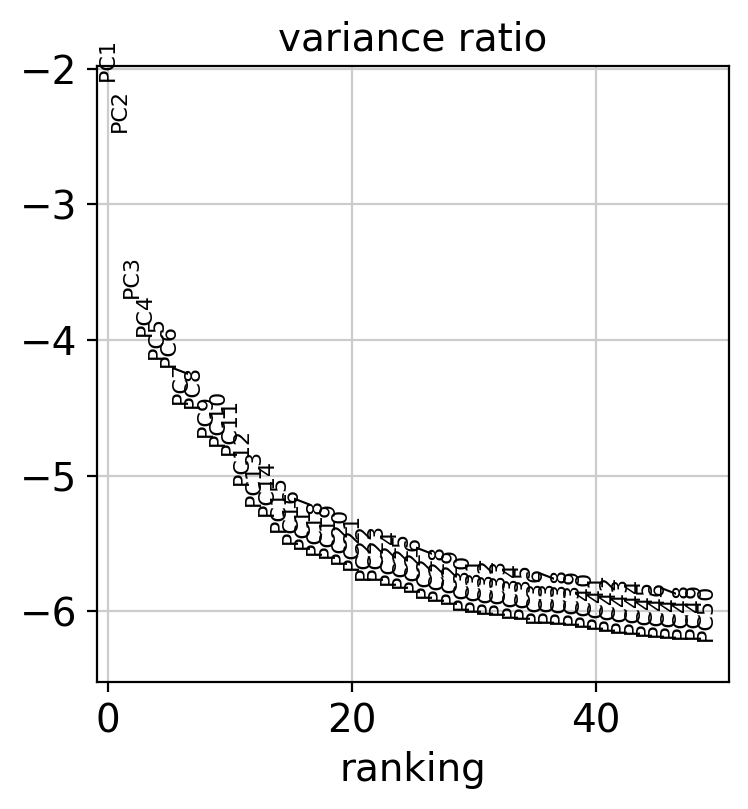

In [107]:
sc.pl.pca_variance_ratio(onlyhuman, log=True, n_pcs=50)

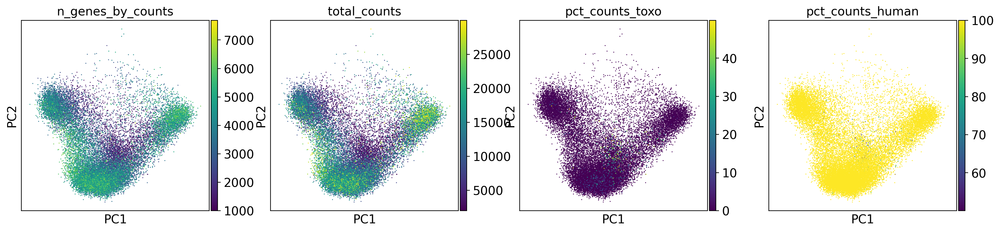

In [108]:
sc.pl.pca(onlyhuman, color=['n_genes_by_counts', 'total_counts', 'pct_counts_toxo', 'pct_counts_human'])

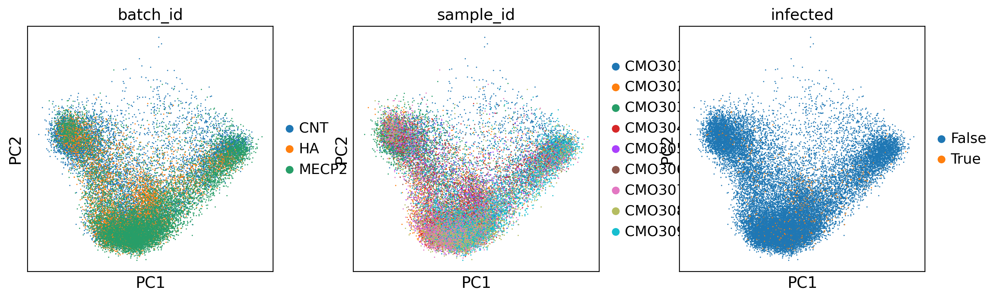

In [109]:
sc.pl.pca(onlyhuman, color=['batch_id', 'sample_id', 'infected'])

## UMAP

In [110]:
sc.pp.neighbors(onlyhuman, n_neighbors=80, n_pcs=18)

computing neighbors
    using 'X_pca' with n_pcs = 18
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:18)


In [111]:
sc.tl.umap(onlyhuman, random_state=1)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)


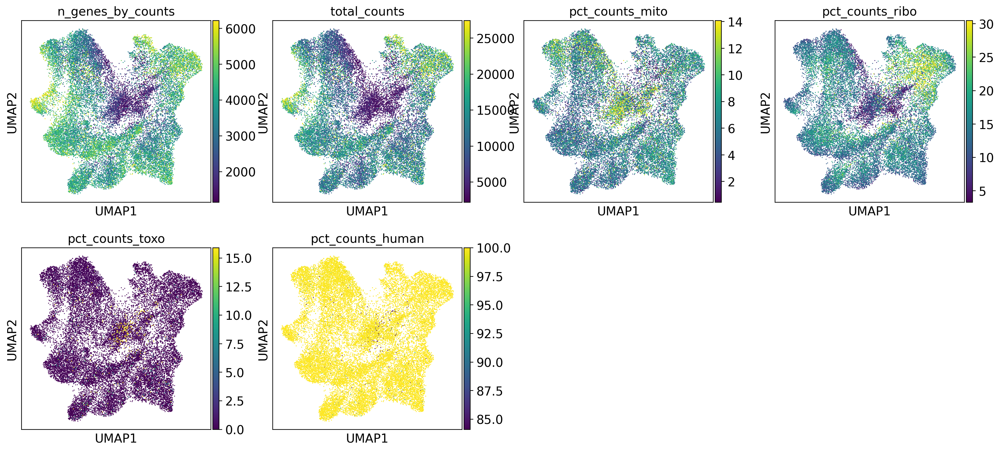

In [112]:
sc.pl.umap(onlyhuman, color=['n_genes_by_counts', 'total_counts', 'pct_counts_mito', 'pct_counts_ribo', 'pct_counts_toxo', 'pct_counts_human'], vmin='p1', vmax='p99')

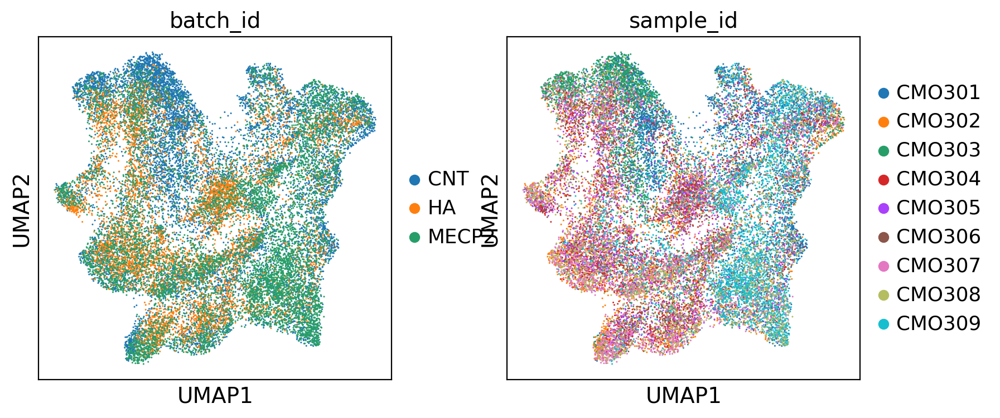

In [113]:
sc.pl.umap(onlyhuman, color=['batch_id', 'sample_id',], vmin='p1', vmax='p99')

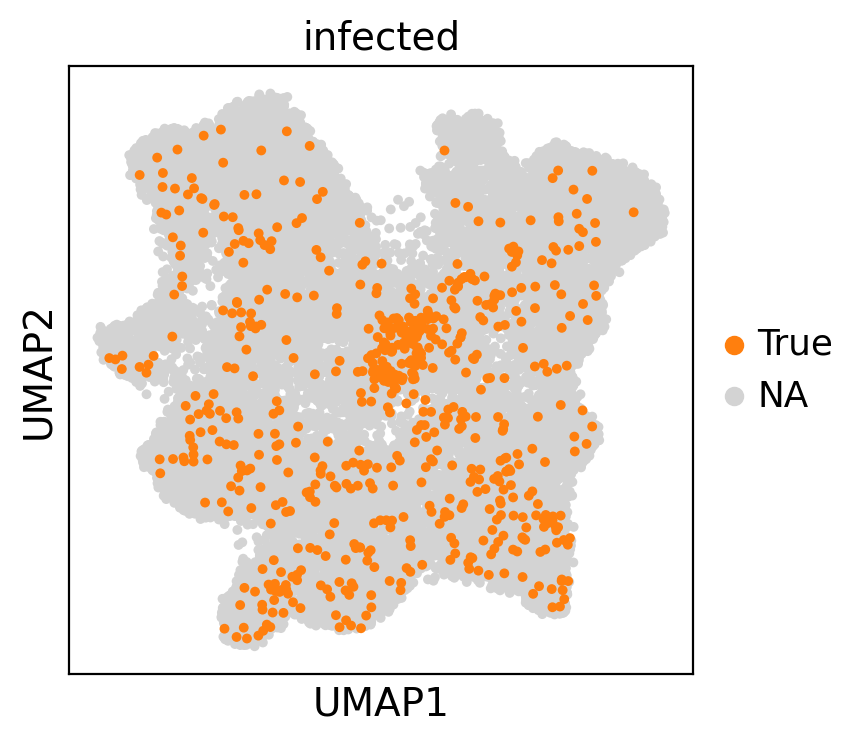

In [114]:
sc.pl.umap(onlyhuman, color="infected", groups="True", size=50, add_outline=False,)

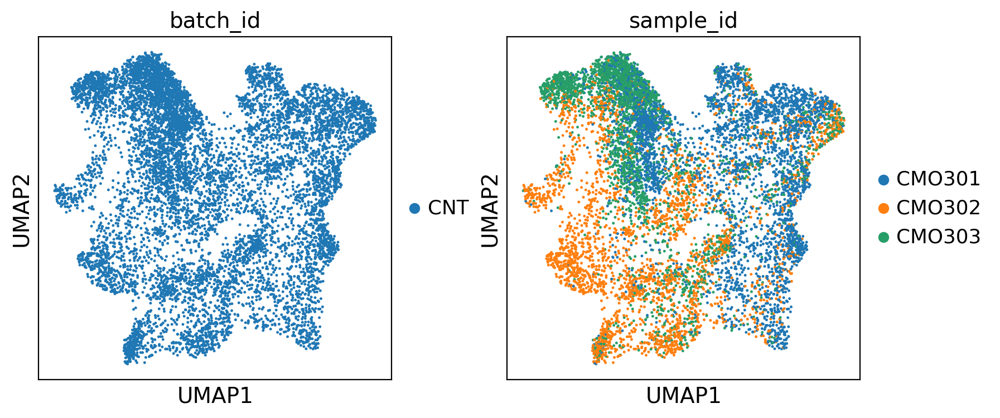

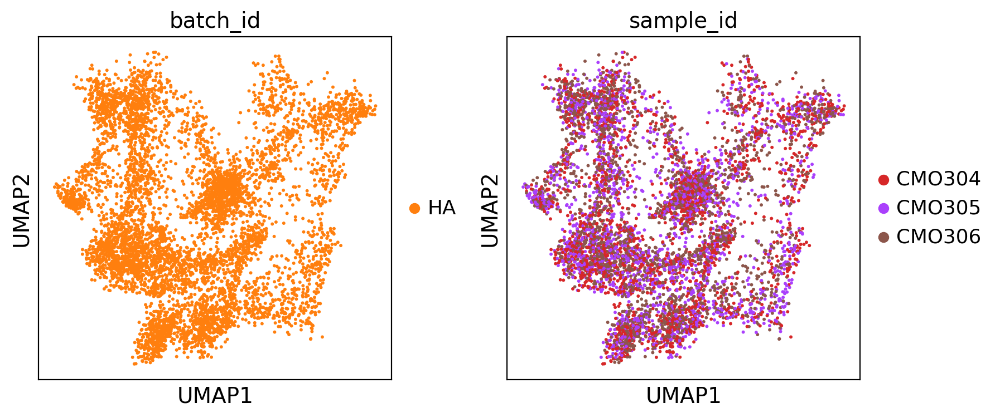

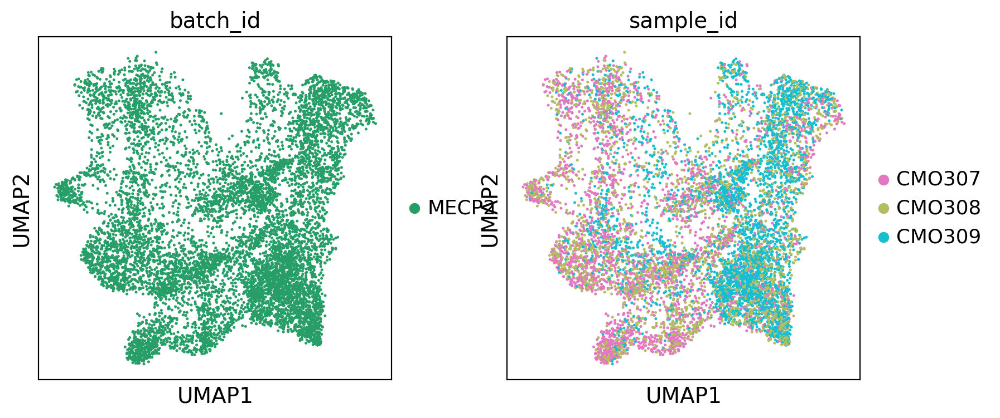

In [115]:
sc.pl.umap(onlyhuman[onlyhuman.obs["batch_id"] == "CNT"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')
sc.pl.umap(onlyhuman[onlyhuman.obs["batch_id"] == "HA"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')
sc.pl.umap(onlyhuman[onlyhuman.obs["batch_id"] == "MECP2"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')

computing density on 'umap'
--> added
    'umap_density_batch_id', densities (adata.obs)
    'umap_density_batch_id_params', parameter (adata.uns)


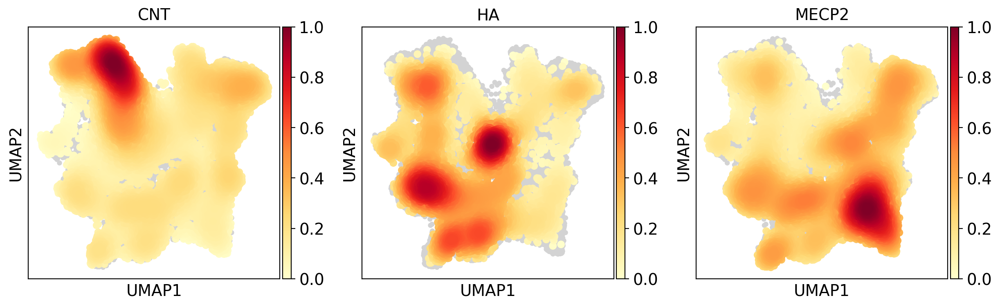

In [116]:
sc.tl.embedding_density(onlyhuman, groupby='batch_id')
sc.pl.embedding_density(onlyhuman, groupby='batch_id')

## Diffusion maps

In [117]:
sc.tl.diffmap(onlyhuman)

computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9928715  0.9912379  0.982829   0.9779939  0.97729486
     0.9717377  0.96707964 0.9602317  0.95803535 0.9546556  0.94991165
     0.94203    0.9402884  0.9400347 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:01)


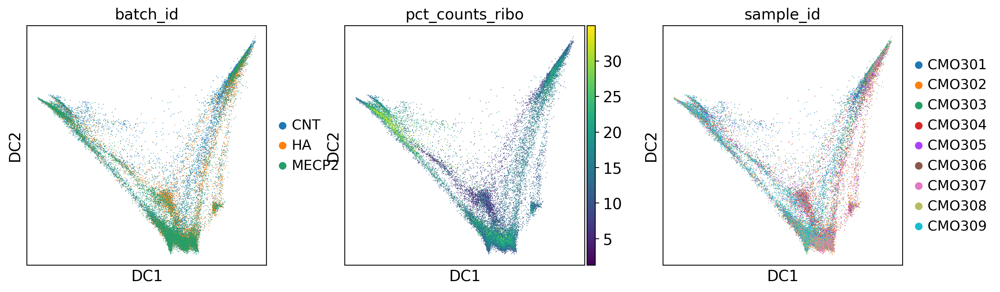

In [118]:
sc.pl.diffmap(onlyhuman, color=['batch_id', 'pct_counts_ribo', 'sample_id'], size=2)

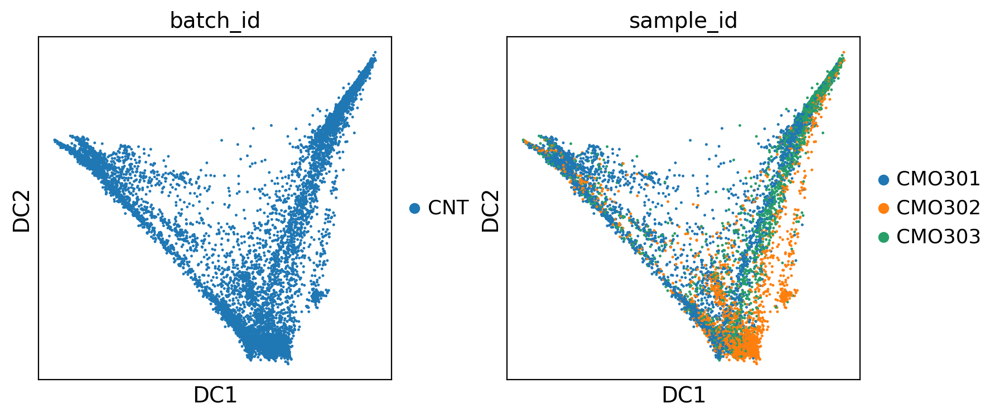

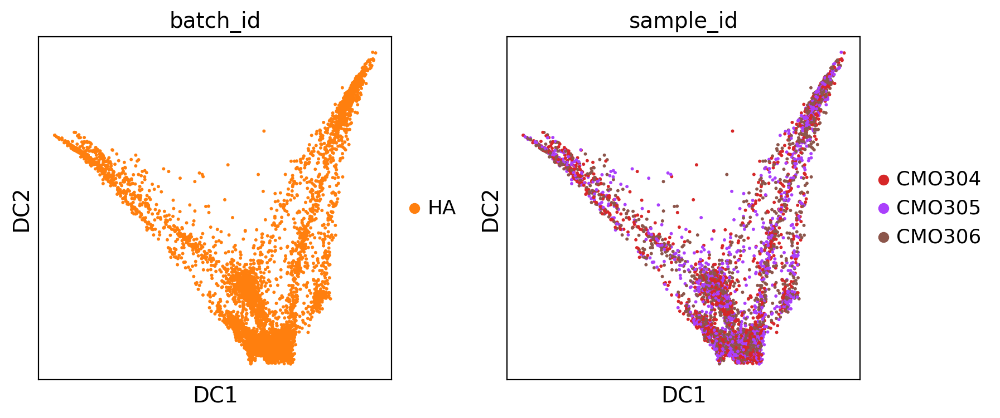

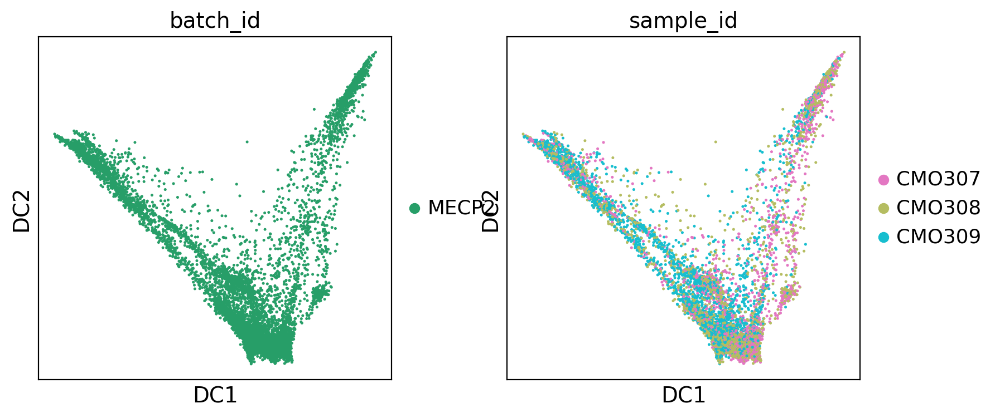

In [119]:
sc.pl.diffmap(onlyhuman[onlyhuman.obs["batch_id"] == "CNT"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')
sc.pl.diffmap(onlyhuman[onlyhuman.obs["batch_id"] == "HA"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')
sc.pl.diffmap(onlyhuman[onlyhuman.obs["batch_id"] == "MECP2"], color=['batch_id', 'sample_id'], vmin='p1', vmax='p99')

## Draw graph

In [120]:
sc.tl.draw_graph(onlyhuman)

drawing single-cell graph using layout 'fa'
    finished: added
    'X_draw_graph_fa', graph_drawing coordinates (adata.obsm) (0:04:05)


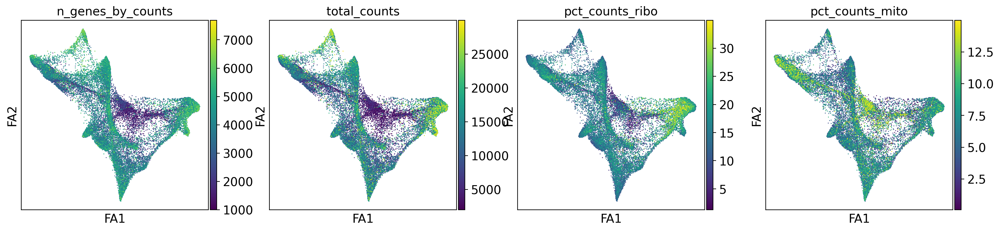

In [121]:
sc.pl.draw_graph(onlyhuman, color=['n_genes_by_counts', 'total_counts', 'pct_counts_ribo', 'pct_counts_mito'])

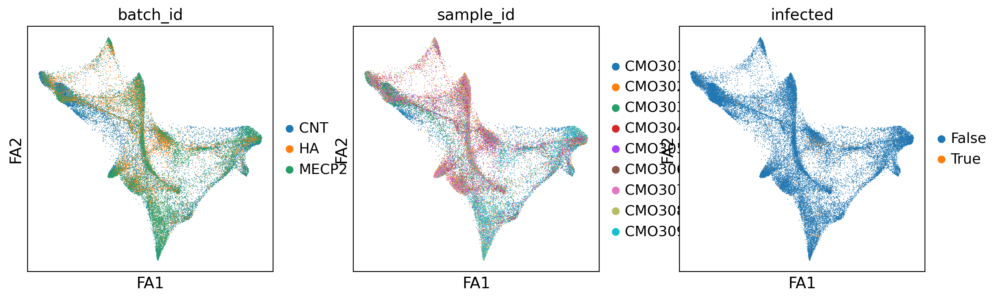

In [122]:
sc.pl.draw_graph(onlyhuman, color=['batch_id', 'sample_id', 'infected'], size=2)

## Marker plots

**the marker plots are collected in the notebook "02-markers.ipynb"**

## Cluster identification

In [123]:
res = [0.3, 0.4, 0.5, 0.6]
leiden_labels = []

for x in res:
    label = "Leiden_" + str(x).replace('.', '')
    leiden_labels.append(label) 
    sc.tl.leiden(onlyhuman, resolution = x, key_added= label)

running Leiden clustering
    finished: found 7 clusters and added
    'Leiden_03', the cluster labels (adata.obs, categorical) (0:00:13)
running Leiden clustering
    finished: found 9 clusters and added
    'Leiden_04', the cluster labels (adata.obs, categorical) (0:00:08)
running Leiden clustering
    finished: found 11 clusters and added
    'Leiden_05', the cluster labels (adata.obs, categorical) (0:00:14)
running Leiden clustering
    finished: found 12 clusters and added
    'Leiden_06', the cluster labels (adata.obs, categorical) (0:00:16)


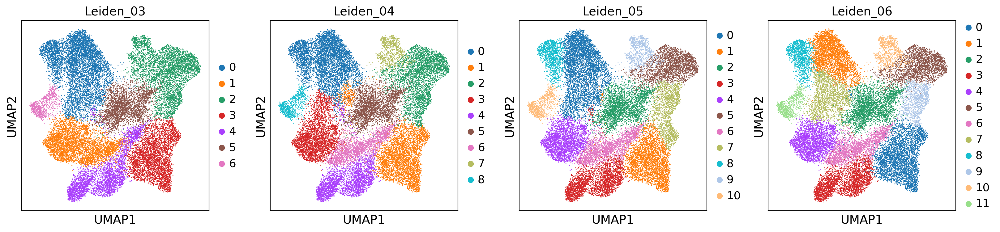

In [124]:
sc.pl.umap(onlyhuman, color=leiden_labels)

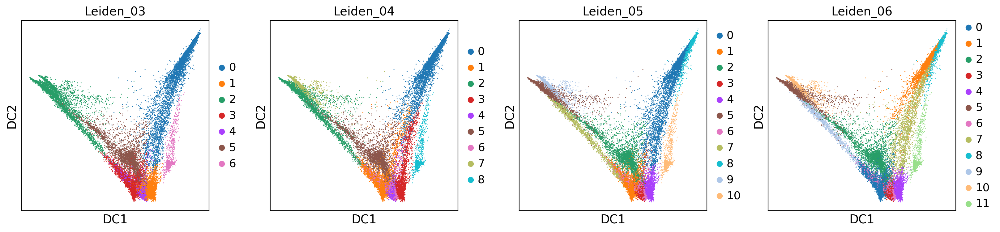

In [125]:
sc.pl.diffmap(onlyhuman, color=leiden_labels)

In [126]:
chosen_leiden = 'Leiden_06'
key_leiden = 'rank_L' + chosen_leiden[-2:]

In [127]:
key_leiden

'rank_L06'

In [128]:
sc.tl.rank_genes_groups(onlyhuman, chosen_leiden, method='wilcoxon', key_added=key_leiden)

ranking genes
    finished: added to `.uns['rank_L06']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:44)


In [129]:
GroupMarkers = pd.DataFrame(onlyhuman.uns[key_leiden]['names']).head(41)
GroupMarkers.columns = 'Cl_' + GroupMarkers.columns
GroupMarkers.head(26)

,Cl_0,Cl_1,Cl_2,Cl_3,Cl_4,Cl_5,Cl_6,Cl_7,Cl_8,Cl_9,Cl_10,Cl_11
0,LHX1-DT,HSPA6,MALAT1,NOVA1,STMN2,VIM,PBX3,HSP90AA1,NEFL,TCF4,HMGB2,PHOX2B
1,LHX1,DNAJB1,WSB1,LHX5-AS1,GAP43,TTYH1,TUBB3,HSP90AB1,DNAJA1,BTG1,TUBA1B,NEFL
2,DNER,HSPH1,SNHG14,ZFHX3,POU2F2,QKI,TUBB2B,HSPD1,CACYBP,GNG5,CENPF,LINC00682
3,EBF3,HSPA8,TUT4,CDH8,YWHAH,C1orf61,GNG3,HSPE1,HSPA1A,MIAT,HMGN2,MAB21L1
4,PBX3,HSPA1A,NEAT1,LUZP2,BASP1,HES4,TUBB,NUDC,DNAJB1,IGFBP2,TOP2A,MAB21L2
5,NETO2,CHORDC1,LUC7L3,MARCKSL1,MAP1B,GPM6B,MARCKSL1,HSPH1,HSPA6,C1orf61,NUSAP1,CALM1
6,NNAT,CACYBP,NKTR,H3F3A,TMSB10,EDNRB,JPT1,HSPB1,HSPB1,PAX3,HMGB1,CALY
7,LHX5-AS1,DNAJA1,LINC00632,ZFHX4,ZFHX3,NTRK2,CD24,TCP1,HSPH1,CHD7,BIRC5,NEFM
8,TUBA1A,HSPA1B,N4BP2L2,LHX1,TUBB2A,NES,IRX3,FKBP4,HSPA8,TFDP2,UBE2C,NRN1
9,TUBB2B,HSP90AA1,SRGAP3,POU3F3,PGM2L1,CXCR4,CIRBP,OAZ1,UBB,ENO1,MKI67,SLC17A6


## Cluster functional analysis

In [130]:
gp = GProfiler(return_dataframe=True)

**Cluster 0**

In [131]:
CustomGO(onlyhuman, cluster='0', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0007399,nervous system development,0.011888,True,"""The process whose specific outcome is the pro...",1356,49,18,14256,0.367347,0.013274,query_1,[GO:0048731]


**Cluster 1**

In [132]:
CustomGO(onlyhuman, cluster='1', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0006457,protein folding,3.419059e-30,True,"""The process of assisting in the covalent and ...",160,48,24,14256,0.500000,0.150000,query_1,[GO:0009987]
1,GO:BP,GO:0006986,response to unfolded protein,1.029186e-20,True,"""Any process that results in a change in state...",100,48,17,14256,0.354167,0.170000,query_1,[GO:0035966]
2,GO:BP,GO:0061077,chaperone-mediated protein folding,1.278624e-20,True,"""The process of inhibiting aggregation and ass...",59,48,15,14256,0.312500,0.254237,query_1,[GO:0006457]
3,GO:BP,GO:0035966,response to topologically incorrect protein,3.274169e-19,True,"""Any process that results in a change in state...",121,48,17,14256,0.354167,0.140496,query_1,"[GO:0006950, GO:0010033]"
4,GO:BP,GO:0009266,response to temperature stimulus,9.542645e-15,True,"""Any process that results in a change in state...",77,48,13,14256,0.270833,0.168831,query_1,[GO:0009628]
5,GO:BP,GO:0009408,response to heat,1.514533e-14,True,"""Any process that results in a change in state...",57,48,12,14256,0.250000,0.210526,query_1,"[GO:0006950, GO:0009266]"
6,GO:BP,GO:0006458,'de novo' protein folding,5.932017e-13,True,"""The process of assisting in the folding of a ...",35,48,10,14256,0.208333,0.285714,query_1,[GO:0006457]
7,GO:BP,GO:0051085,chaperone cofactor-dependent protein refolding,3.758214e-12,True,"""The process of assisting in the correct postt...",26,48,9,14256,0.187500,0.346154,query_1,"[GO:0051084, GO:0061077]"


**Cluster 2**

In [133]:
CustomGO(onlyhuman, cluster='2', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0015988,"energy coupled proton transmembrane transport,...",0.007614,True,"""The transport of protons across a membrane an...",4,49,3,14256,0.061224,0.750000,query_1,[GO:1902600]
1,GO:BP,GO:0015990,electron transport coupled proton transport,0.007614,True,"""The transport of protons against an electroch...",4,49,3,14256,0.061224,0.750000,query_1,[GO:0015988]
2,GO:BP,GO:0006119,oxidative phosphorylation,0.009533,True,"""The phosphorylation of ADP to ATP that accomp...",123,49,7,14256,0.142857,0.056911,query_1,[GO:0009060]
3,GO:CC,GO:0098803,respiratory chain complex,0.014893,True,"""Any protein complex that is part of a respira...",80,49,6,14256,0.122449,0.075000,query_1,"[GO:0070469, GO:0098796]"
4,GO:BP,GO:0019646,aerobic electron transport chain,0.014893,True,"""A process in which a series of electron carri...",80,49,6,14256,0.122449,0.075000,query_1,"[GO:0006119, GO:0009060, GO:0022904]"
5,GO:CC,GO:0005746,mitochondrial respirasome,0.022942,True,"""The protein complexes that form the mitochond...",86,49,6,14256,0.122449,0.069767,query_1,"[GO:0005743, GO:0070469]"
6,GO:CC,GO:0070469,respirasome,0.022942,True,"""The protein complexes that form the electron ...",86,49,6,14256,0.122449,0.069767,query_1,"[GO:0016020, GO:0110165]"
7,GO:BP,GO:0042773,ATP synthesis coupled electron transport,0.022942,True,"""The transfer of electrons through a series of...",86,49,6,14256,0.122449,0.069767,query_1,"[GO:0006119, GO:0022904]"


**Cluster 3**

In [134]:
CustomGO(onlyhuman, cluster='3', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0007399,nervous system development,0.023224,True,"""The process whose specific outcome is the pro...",1356,46,17,14256,0.369565,0.012537,query_1,[GO:0048731]
1,GO:BP,GO:0022008,neurogenesis,0.030367,True,"""Generation of cells within the nervous system...",912,46,14,14256,0.304348,0.015351,query_1,"[GO:0007399, GO:0030154]"
2,GO:BP,GO:0030182,neuron differentiation,0.034728,True,"""The process in which a relatively unspecializ...",782,46,13,14256,0.282609,0.016624,query_1,"[GO:0030154, GO:0048699]"


**Cluster 4**

In [135]:
CustomGO(onlyhuman, cluster='4', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0048699,generation of neurons,1.754982e-07,True,"""The process in which nerve cells are generate...",822,47,19,14256,0.404255,0.023114,query_1,[GO:0022008]
1,GO:BP,GO:0007399,nervous system development,2.258729e-07,True,"""The process whose specific outcome is the pro...",1356,47,23,14256,0.489362,0.016962,query_1,[GO:0048731]
2,GO:BP,GO:0030182,neuron differentiation,8.459130e-07,True,"""The process in which a relatively unspecializ...",782,47,18,14256,0.382979,0.023018,query_1,"[GO:0030154, GO:0048699]"
3,GO:BP,GO:0022008,neurogenesis,1.080266e-06,True,"""Generation of cells within the nervous system...",912,47,19,14256,0.404255,0.020833,query_1,"[GO:0007399, GO:0030154]"
4,GO:BP,GO:0048731,system development,1.764347e-06,True,"""The process whose specific outcome is the pro...",2181,47,27,14256,0.574468,0.012380,query_1,"[GO:0007275, GO:0048856]"
5,GO:BP,GO:0007275,multicellular organism development,1.310608e-05,True,"""The biological process whose specific outcome...",2375,47,27,14256,0.574468,0.011368,query_1,"[GO:0032501, GO:0048856]"
6,GO:BP,GO:0048856,anatomical structure development,3.670251e-05,True,"""The biological process whose specific outcome...",2901,47,29,14256,0.617021,0.009997,query_1,[GO:0032502]
7,GO:BP,GO:0032502,developmental process,6.538401e-05,True,"""A biological process whose specific outcome i...",3194,47,30,14256,0.638298,0.009393,query_1,[GO:0008150]


**Cluster 5**

In [136]:
CustomGO(onlyhuman, cluster='5', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0022626,cytosolic ribosome,3.995135e-15,True,"""A ribosome located in the cytosol."" [GOC:mtg_...",98,48,14,14256,0.291667,0.142857,query_1,"[GO:0005829, GO:0005840]"
1,GO:BP,GO:0002181,cytoplasmic translation,2.590344e-12,True,"""The chemical reactions and pathways resulting...",153,48,14,14256,0.291667,0.091503,query_1,[GO:0006412]
2,GO:CC,GO:0044391,ribosomal subunit,3.555097e-11,True,"""Either of the two subunits of a ribosome: the...",184,48,14,14256,0.291667,0.076087,query_1,"[GO:0005840, GO:1990904]"
3,GO:CC,GO:0005840,ribosome,1.623629e-10,True,"""An intracellular organelle, about 200 A in di...",205,48,14,14256,0.291667,0.068293,query_1,[GO:0043232]
4,GO:BP,GO:0006518,peptide metabolic process,4.400329e-10,True,"""The chemical reactions and pathways involving...",665,48,20,14256,0.416667,0.030075,query_1,"[GO:0043603, GO:1901564]"
5,GO:BP,GO:0006412,translation,4.391843e-08,True,"""The cellular metabolic process in which a pro...",545,48,17,14256,0.354167,0.031193,query_1,"[GO:0010467, GO:0019538, GO:0034645, GO:0043043]"
6,GO:BP,GO:0043603,cellular amide metabolic process,4.714011e-08,True,"""The chemical reactions and pathways involving...",853,48,20,14256,0.416667,0.023447,query_1,[GO:0034641]
7,GO:BP,GO:0043043,peptide biosynthetic process,6.415952e-08,True,"""The chemical reactions and pathways resulting...",558,48,17,14256,0.354167,0.030466,query_1,"[GO:0006518, GO:0043604, GO:1901566]"


**Cluster 6**

In [137]:
CustomGO(onlyhuman, cluster='6', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0030182,neuron differentiation,0.000775,True,"""The process in which a relatively unspecializ...",782,47,15,14256,0.319149,0.019182,query_1,"[GO:0030154, GO:0048699]"
1,GO:BP,GO:0022008,neurogenesis,0.000791,True,"""Generation of cells within the nervous system...",912,47,16,14256,0.340426,0.017544,query_1,"[GO:0007399, GO:0030154]"
2,GO:BP,GO:0007399,nervous system development,0.000884,True,"""The process whose specific outcome is the pro...",1356,47,19,14256,0.404255,0.014012,query_1,[GO:0048731]
3,GO:BP,GO:0048699,generation of neurons,0.001510,True,"""The process in which nerve cells are generate...",822,47,15,14256,0.319149,0.018248,query_1,[GO:0022008]
4,GO:BP,GO:0048666,neuron development,0.004656,True,"""The process whose specific outcome is the pro...",641,47,13,14256,0.276596,0.020281,query_1,"[GO:0030182, GO:0048468]"
5,GO:BP,GO:0048468,cell development,0.004916,True,"""The process whose specific outcome is the pro...",1039,47,16,14256,0.340426,0.015399,query_1,"[GO:0030154, GO:0048856, GO:0048869]"


**Cluster 7**

In [138]:
CustomGO(onlyhuman, cluster='7', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0006457,protein folding,1.117651e-22,True,"""The process of assisting in the covalent and ...",160,47,20,14256,0.425532,0.125000,query_1,[GO:0009987]
1,GO:BP,GO:0061077,chaperone-mediated protein folding,1.794973e-14,True,"""The process of inhibiting aggregation and ass...",59,47,12,14256,0.255319,0.203390,query_1,[GO:0006457]
2,GO:CC,GO:0101031,chaperone complex,2.146338e-12,True,"""A protein complex required for the non-covale...",40,47,10,14256,0.212766,0.250000,query_1,[GO:0140535]
3,GO:BP,GO:0006986,response to unfolded protein,8.130576e-10,True,"""Any process that results in a change in state...",100,47,11,14256,0.234043,0.110000,query_1,[GO:0035966]
4,GO:CC,GO:0005832,chaperonin-containing T-complex,3.843631e-09,True,"""A multisubunit ring-shaped complex that media...",9,47,6,14256,0.127660,0.666667,query_1,"[GO:0005829, GO:0101031]"
5,GO:BP,GO:0035966,response to topologically incorrect protein,6.979409e-09,True,"""Any process that results in a change in state...",121,47,11,14256,0.234043,0.090909,query_1,"[GO:0006950, GO:0010033]"
6,GO:BP,GO:1904851,positive regulation of establishment of protei...,9.585379e-09,True,"""Any process that activates or increases the f...",10,47,6,14256,0.127660,0.600000,query_1,"[GO:0070200, GO:0070203, GO:1904816, GO:1904951]"
7,GO:CC,GO:0070062,extracellular exosome,1.777651e-08,True,"""A vesicle that is released into the extracell...",1486,47,25,14256,0.531915,0.016824,query_1,"[GO:0005615, GO:1903561]"


**Cluster 8**

In [139]:
CustomGO(onlyhuman, cluster='8', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0006457,protein folding,1.773862e-28,True,"""The process of assisting in the covalent and ...",160,47,23,14256,0.489362,0.143750,query_1,[GO:0009987]
1,GO:BP,GO:0006986,response to unfolded protein,6.683679e-21,True,"""Any process that results in a change in state...",100,47,17,14256,0.361702,0.170000,query_1,[GO:0035966]
2,GO:BP,GO:0035966,response to topologically incorrect protein,2.129275e-19,True,"""Any process that results in a change in state...",121,47,17,14256,0.361702,0.140496,query_1,"[GO:0006950, GO:0010033]"
3,GO:BP,GO:0061077,chaperone-mediated protein folding,1.262403e-18,True,"""The process of inhibiting aggregation and ass...",59,47,14,14256,0.297872,0.237288,query_1,[GO:0006457]
4,GO:BP,GO:0006458,'de novo' protein folding,4.703698e-13,True,"""The process of assisting in the folding of a ...",35,47,10,14256,0.212766,0.285714,query_1,[GO:0006457]
5,GO:BP,GO:0009266,response to temperature stimulus,5.655690e-13,True,"""Any process that results in a change in state...",77,47,12,14256,0.255319,0.155844,query_1,[GO:0009628]
6,GO:BP,GO:0009408,response to heat,1.170678e-12,True,"""Any process that results in a change in state...",57,47,11,14256,0.234043,0.192982,query_1,"[GO:0006950, GO:0009266]"
7,GO:BP,GO:0051085,chaperone cofactor-dependent protein refolding,3.056838e-12,True,"""The process of assisting in the correct postt...",26,47,9,14256,0.191489,0.346154,query_1,"[GO:0051084, GO:0061077]"


**Cluster 9**

In [140]:
CustomGO(onlyhuman, cluster='9', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:CC,GO:0022626,cytosolic ribosome,0.000067,True,"""A ribosome located in the cytosol."" [GOC:mtg_...",98,49,8,14256,0.163265,0.081633,query_1,"[GO:0005829, GO:0005840]"
1,GO:BP,GO:0002181,cytoplasmic translation,0.002276,True,"""The chemical reactions and pathways resulting...",153,49,8,14256,0.163265,0.052288,query_1,[GO:0006412]
2,GO:BP,GO:0008219,cell death,0.006176,True,"""Any biological process that results in perman...",1149,49,17,14256,0.346939,0.014795,query_1,[GO:0009987]
3,GO:CC,GO:0044391,ribosomal subunit,0.009490,True,"""Either of the two subunits of a ribosome: the...",184,49,8,14256,0.163265,0.043478,query_1,"[GO:0005840, GO:1990904]"
4,GO:BP,GO:0012501,programmed cell death,0.010043,True,"""A process which begins when a cell receives a...",1043,49,16,14256,0.326531,0.015340,query_1,[GO:0008219]
5,GO:CC,GO:0022627,cytosolic small ribosomal subunit,0.021431,True,"""The small subunit of a ribosome located in th...",45,49,5,14256,0.102041,0.111111,query_1,"[GO:0015935, GO:0022626]"
6,GO:CC,GO:0005840,ribosome,0.021687,True,"""An intracellular organelle, about 200 A in di...",205,49,8,14256,0.163265,0.039024,query_1,[GO:0043232]
7,GO:BP,GO:0006915,apoptotic process,0.041515,True,"""A programmed cell death process which begins ...",1011,49,15,14256,0.306122,0.014837,query_1,[GO:0012501]


**Cluster 10**

In [141]:
CustomGO(onlyhuman, cluster='10', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0000278,mitotic cell cycle,7.894531e-26,True,"""Progression through the phases of the mitotic...",742,47,32,14256,0.680851,0.043127,query_1,[GO:0007049]
1,GO:BP,GO:0007049,cell cycle,1.199925e-23,True,"""The progression of biochemical and morphologi...",1193,47,35,14256,0.744681,0.029338,query_1,[GO:0009987]
2,GO:BP,GO:1903047,mitotic cell cycle process,2.330557e-20,True,"""A process that is part of the mitotic cell cy...",622,47,27,14256,0.574468,0.043408,query_1,"[GO:0000278, GO:0022402]"
3,GO:BP,GO:0022402,cell cycle process,7.929821e-20,True,"""The cellular process that ensures successive ...",929,47,30,14256,0.638298,0.032293,query_1,"[GO:0007049, GO:0009987]"
4,GO:BP,GO:0140014,mitotic nuclear division,2.836663e-16,True,"""A mitotic cell cycle process comprising the s...",274,47,19,14256,0.404255,0.069343,query_1,"[GO:0000280, GO:1903047]"
5,GO:BP,GO:0000280,nuclear division,6.588301e-16,True,"""The division of a cell nucleus into two nucle...",343,47,20,14256,0.425532,0.058309,query_1,[GO:0048285]
6,GO:BP,GO:0007059,chromosome segregation,1.408172e-15,True,"""The process in which genetic material, in the...",298,47,19,14256,0.404255,0.063758,query_1,[GO:0009987]
7,GO:BP,GO:0048285,organelle fission,5.048711e-15,True,"""The creation of two or more organelles by div...",380,47,20,14256,0.425532,0.052632,query_1,[GO:0006996]


**Cluster 11**

In [142]:
CustomGO(onlyhuman, cluster='11', rank=key_leiden, n_markers=50,  show=8)

,source,native,name,p_value,significant,description,term_size,query_size,intersection_size,effective_domain_size,precision,recall,query,parents
0,GO:BP,GO:0009653,anatomical structure morphogenesis,0.000186,True,"""The process in which anatomical structures ar...",1351,48,20,14256,0.416667,0.014804,query_1,"[GO:0032502, GO:0048856]"
1,GO:BP,GO:0048812,neuron projection morphogenesis,0.003370,True,"""The process in which the anatomical structure...",401,48,11,14256,0.229167,0.027431,query_1,"[GO:0031175, GO:0120039]"
2,GO:BP,GO:0120039,plasma membrane bounded cell projection morpho...,0.004659,True,"""The process in which the anatomical structure...",414,48,11,14256,0.229167,0.026570,query_1,[GO:0048858]
3,GO:BP,GO:0048731,system development,0.004956,True,"""The process whose specific outcome is the pro...",2181,48,23,14256,0.479167,0.010546,query_1,"[GO:0007275, GO:0048856]"
4,GO:BP,GO:0048858,cell projection morphogenesis,0.005012,True,"""The process in which the anatomical structure...",417,48,11,14256,0.229167,0.026379,query_1,"[GO:0000902, GO:0030030, GO:0032990]"
5,GO:BP,GO:0032990,cell part morphogenesis,0.006369,True,"""The process in which the anatomical structure...",427,48,11,14256,0.229167,0.025761,query_1,[GO:0032989]
6,GO:BP,GO:0007399,nervous system development,0.008250,True,"""The process whose specific outcome is the pro...",1356,48,18,14256,0.375000,0.013274,query_1,[GO:0048731]
7,GO:BP,GO:0030182,neuron differentiation,0.008377,True,"""The process in which a relatively unspecializ...",782,48,14,14256,0.291667,0.017903,query_1,"[GO:0030154, GO:0048699]"


## Cluster annotation

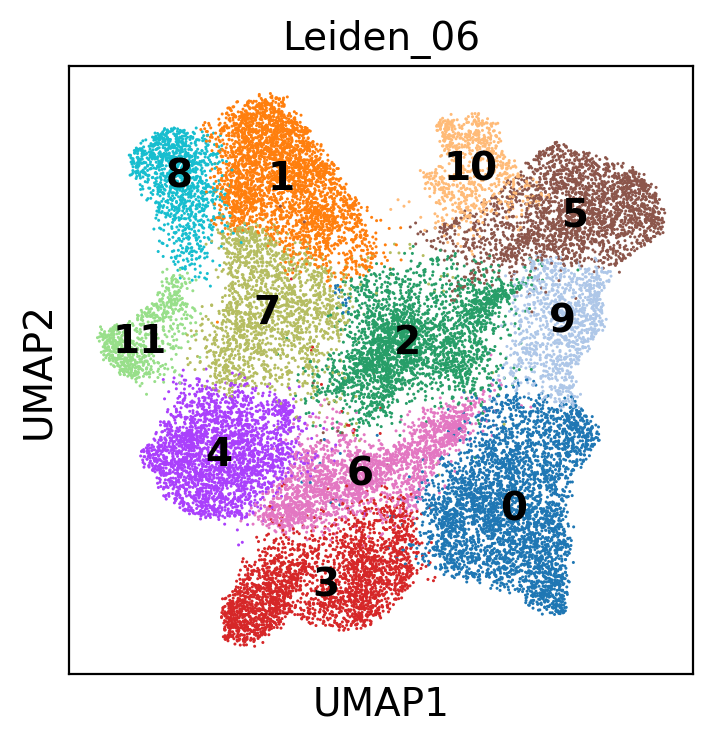

In [143]:
sc.pl.umap(onlyhuman, color=[chosen_leiden], legend_loc='on data')

In [144]:
onlyhuman.obs["celltype"] = onlyhuman.obs[chosen_leiden].map(
 {"0": "N_IP",
  "1": "N_UPR",
  "2": "N_Syn",
  "3": "N1",
  "4": "N2",
  "5": "vRG_oRG",
  "6": "N3",
  "7": "N_UPR2",
  "8": "N_UPR3", 
  "9": "vRG_oRG2",
  "10": "CyclingProg",
  "11": "N_Proj",}   
)

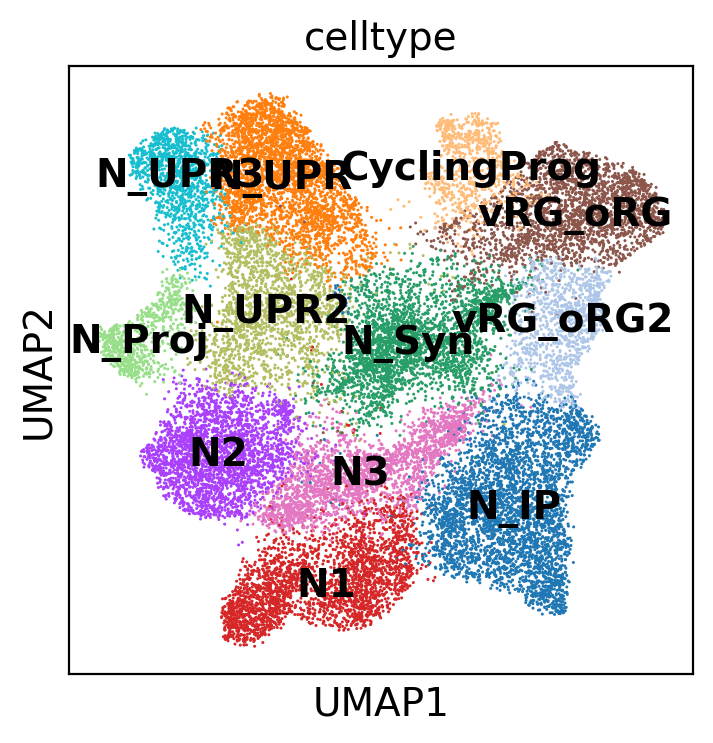

In [145]:
sc.pl.umap(onlyhuman, color=["celltype"], legend_loc='on data')

In [146]:
adata.obs["celltype"] = onlyhuman.obs["celltype"]

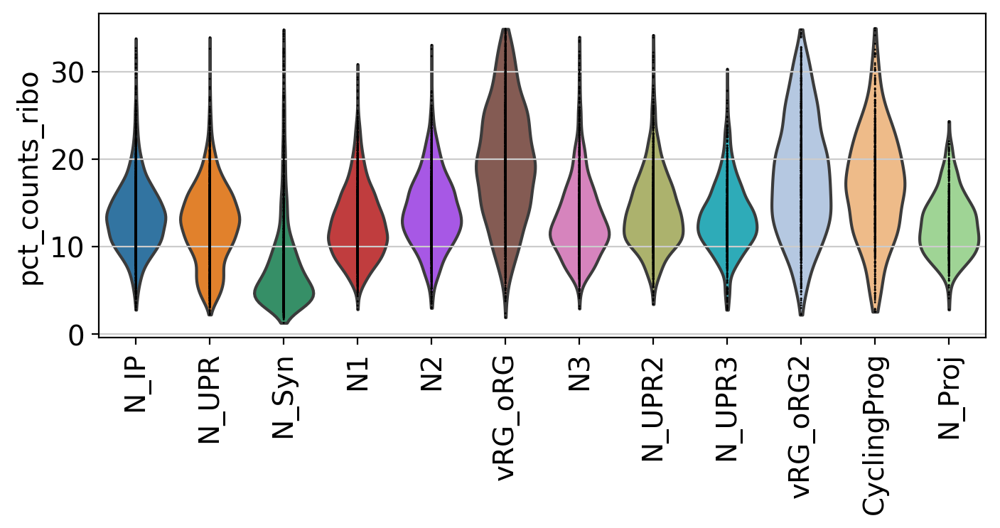

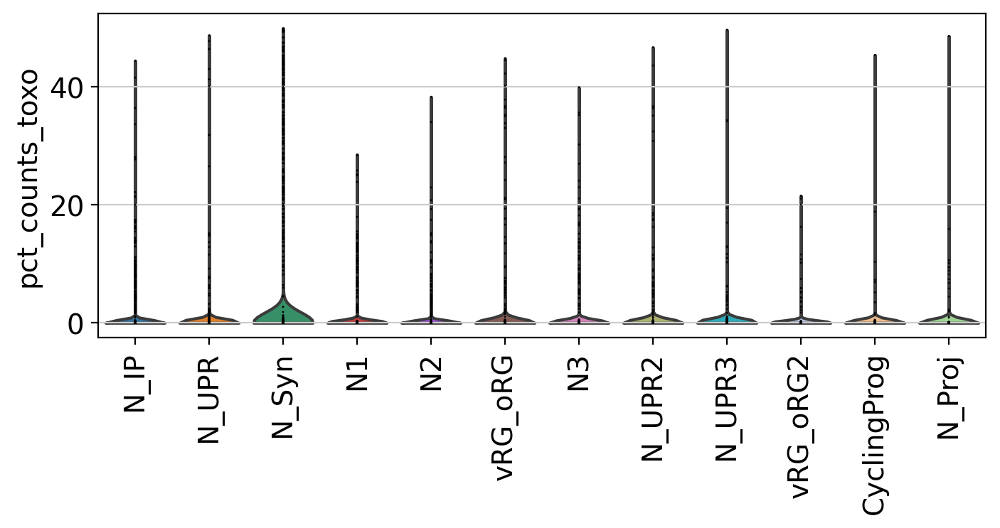

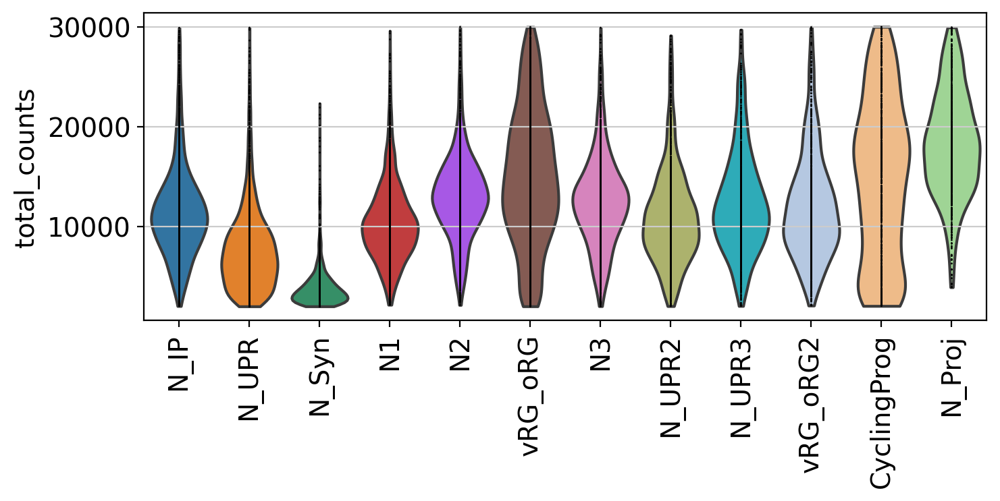

In [147]:
fig, ax = plt.subplots(figsize=(8,3))
sc.pl.violin(onlyhuman, ['pct_counts_ribo'], groupby='celltype', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(8,3))
sc.pl.violin(onlyhuman, ['pct_counts_toxo'], groupby='celltype', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(8,3))
sc.pl.violin(onlyhuman, ['total_counts'], groupby='celltype', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

# Metrics of infected vs infected neurons

In [148]:
onlyhuman.layers['scaled'] = sc.pp.scale(onlyhuman, copy=True).X

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [149]:
onlyhuman.obs["sample_infect"] = onlyhuman.obs["sample_id"].astype(str) + "_" +  onlyhuman.obs["infected"].astype(str)

In [150]:
N_clusters = onlyhuman[onlyhuman.obs["celltype"].isin(['N1', 'N2', 'N3'])].copy()
N_clusters

AnnData object with n_obs × n_vars = 7693 × 16240
    obs: 'batch_id', 'sample_id', 'n_genes_by_counts', 'total_counts', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_mito', 'pct_counts_mito', 'total_counts_toxo', 'pct_counts_toxo', 'total_counts_human', 'pct_counts_human', 'total_counts_HA', 'pct_counts_HA', 'total_counts_Mecp2', 'pct_counts_Mecp2', 'n_genes', 'n_counts', 'umap_density_batch_id', 'Leiden_03', 'Leiden_04', 'Leiden_05', 'Leiden_06', 'infected', 'batch_infect', 'celltype', 'sample_infect'
    var: 'gene_ids', 'feature_types', 'ribo', 'mito', 'toxo', 'human', 'HA', 'Mecp2', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'triku_distance', 'triku_distance_uncorrected', 'triku_highly_variable'
    uns: 'log1p', 'pca', 'neighbors', 'triku_params', 'batch_id_colors', 'sample_id_colors', 'infected_colors', 'umap', 'umap_density_batch_id_params', 'diffmap_evals', 'draw_graph', 'leiden', 'Leiden_03_colors', 'Leiden_04_color

... storing 'sample_infect' as categorical


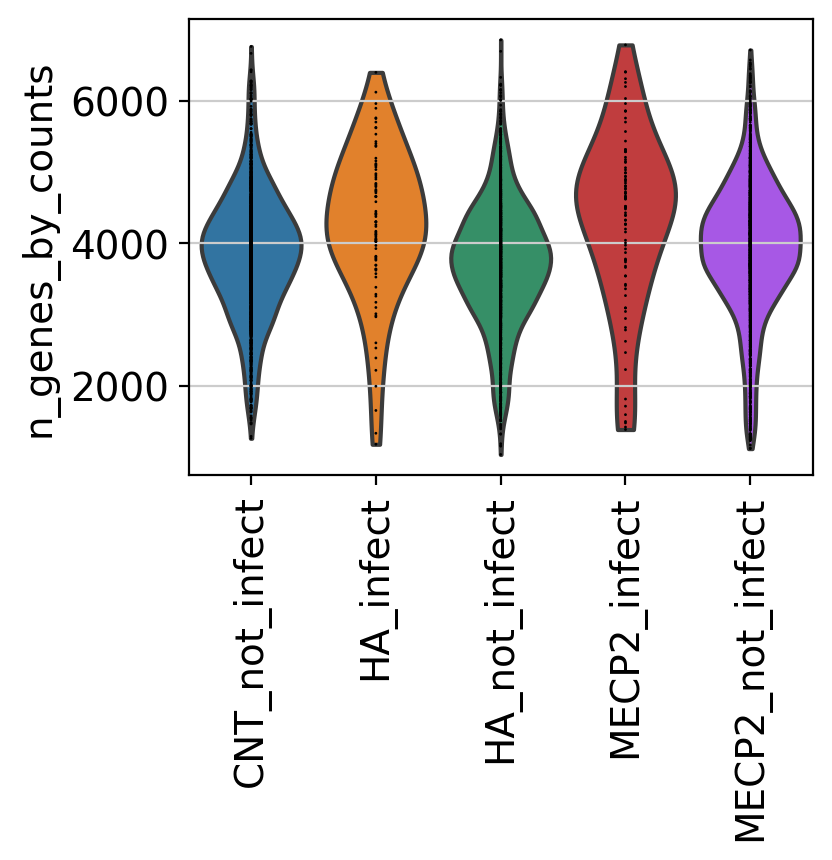

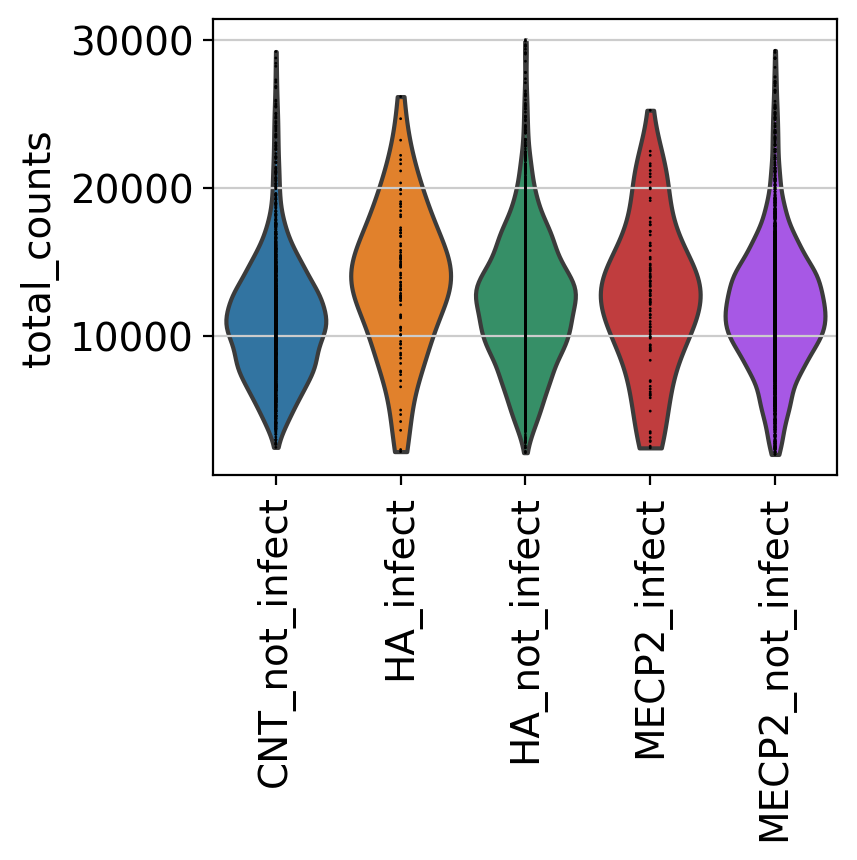

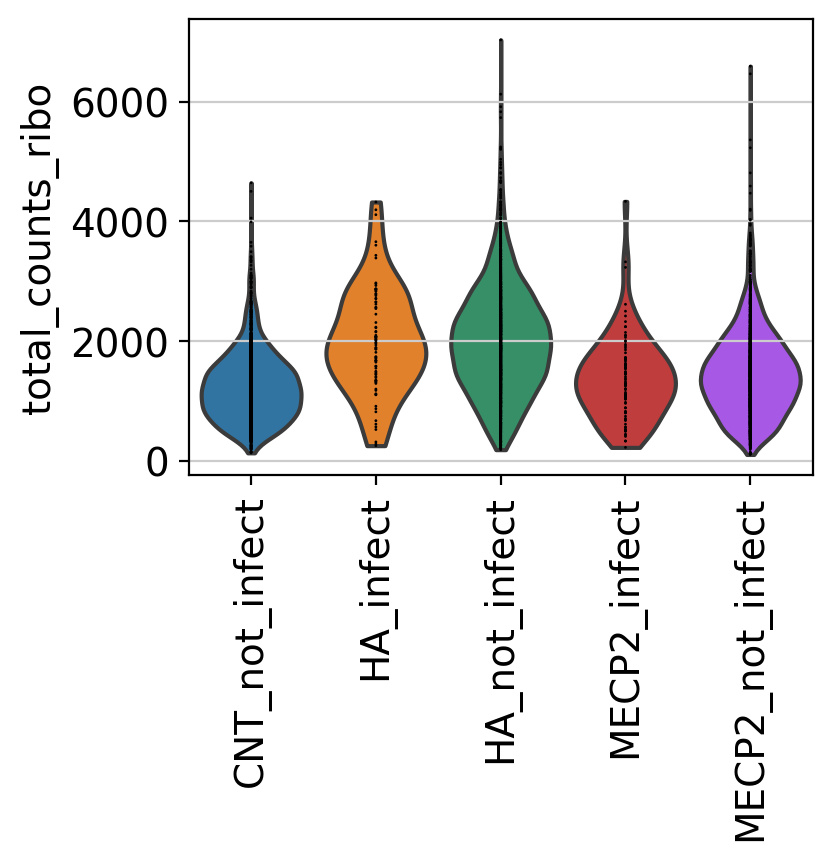

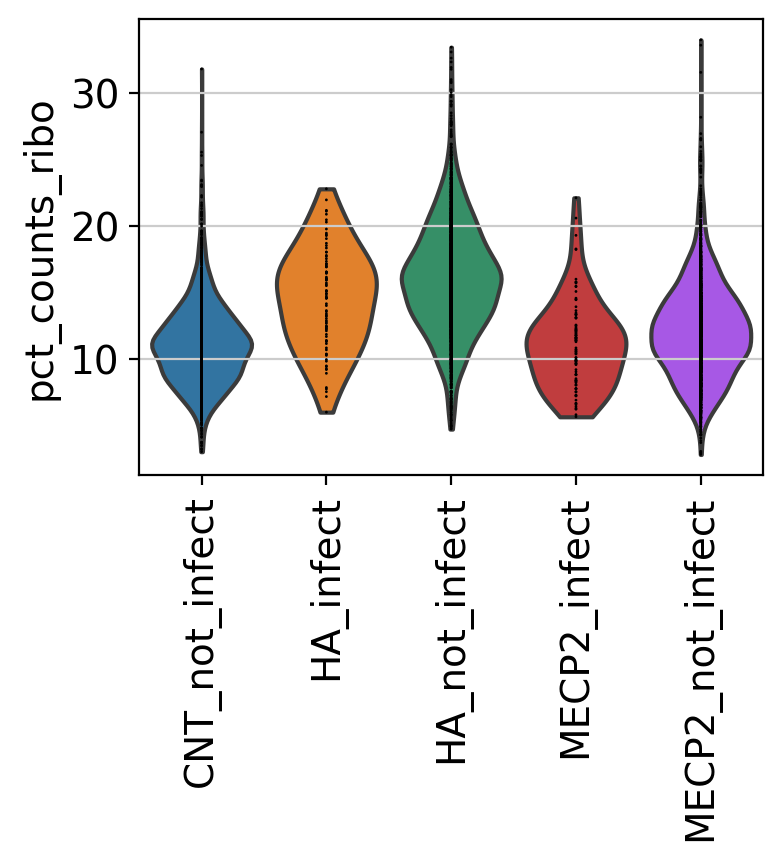

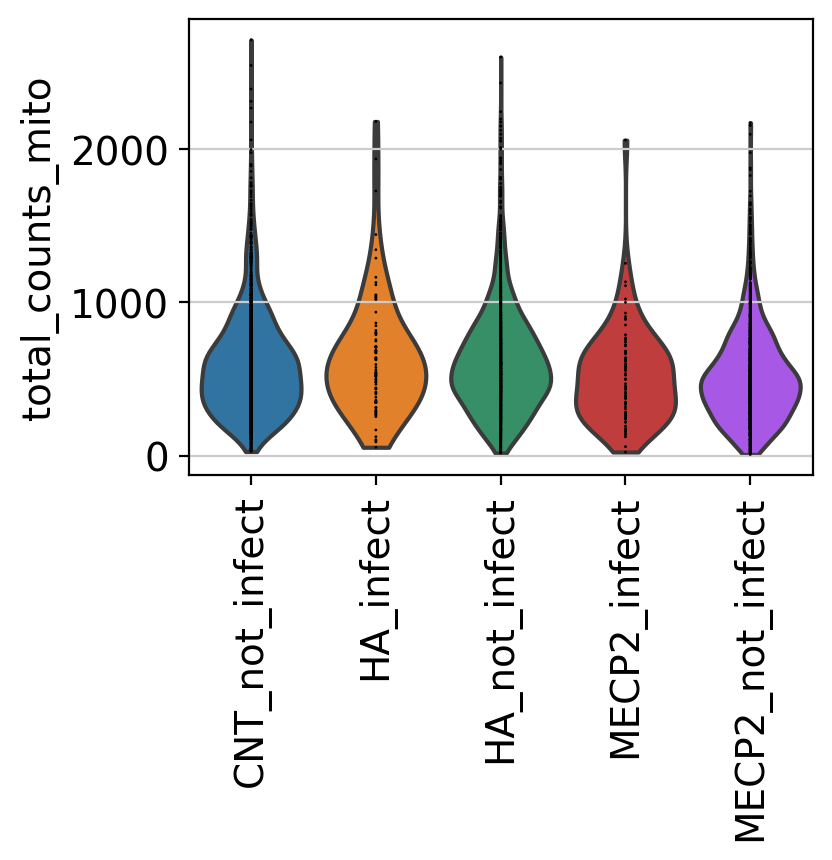

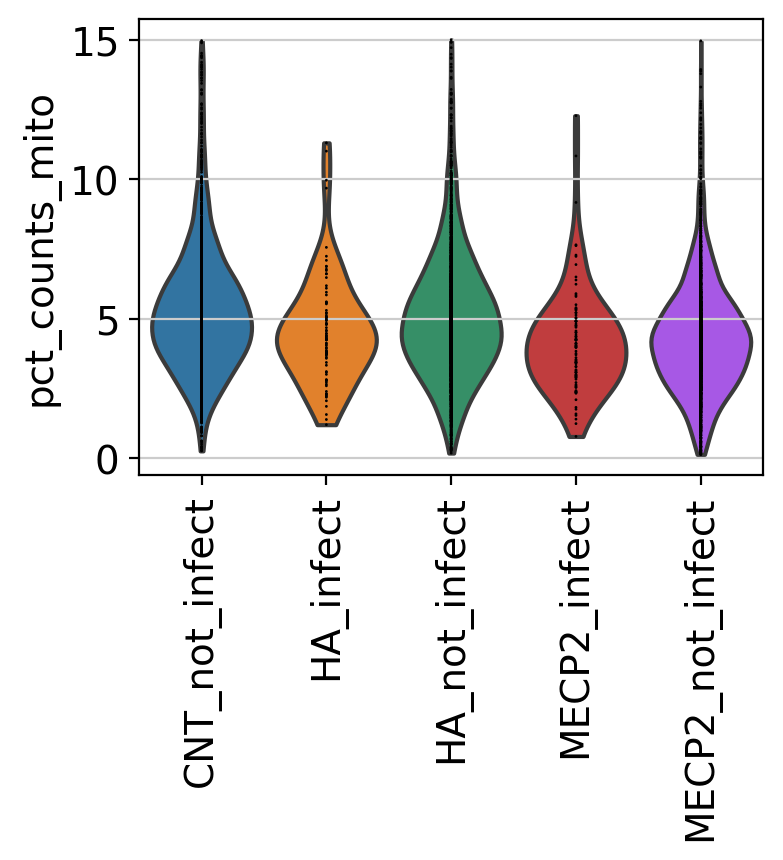

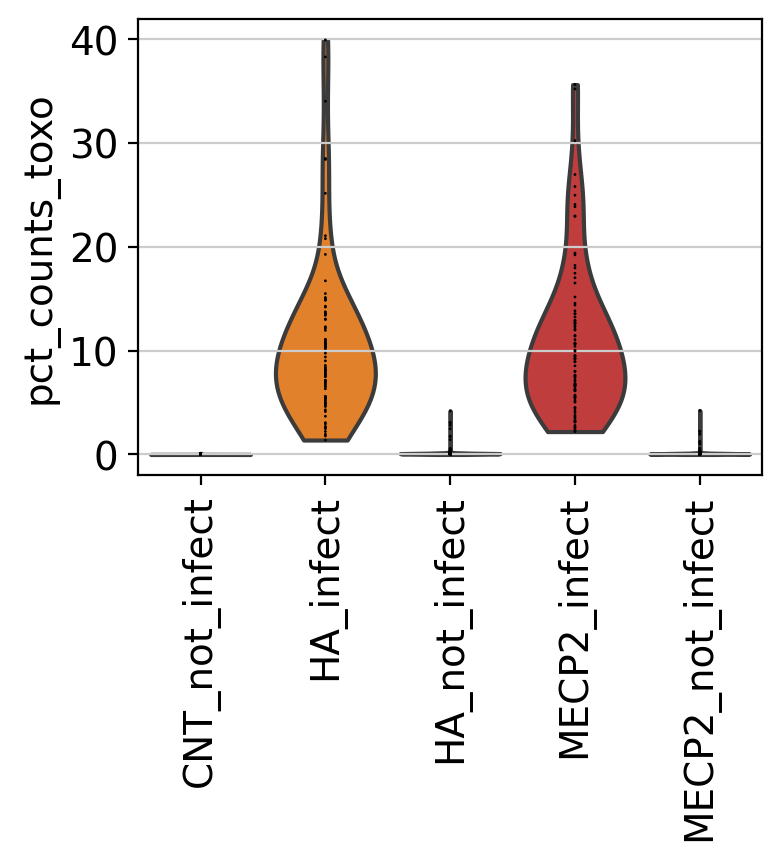

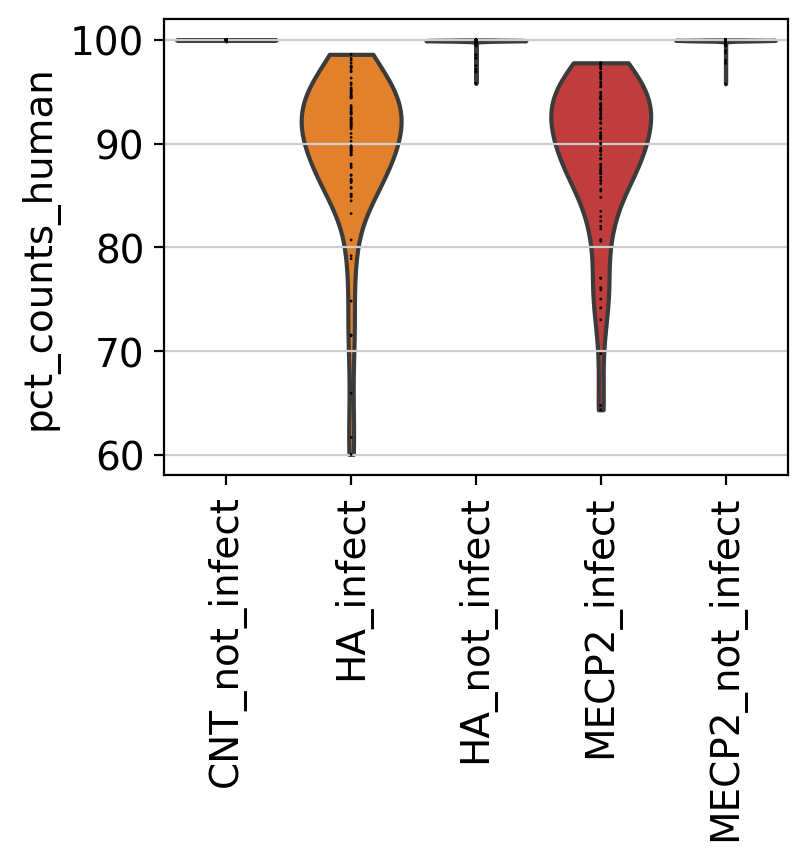

In [151]:
fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['n_genes_by_counts'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['total_counts'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['total_counts_ribo'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['pct_counts_ribo'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['total_counts_mito'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['pct_counts_mito'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['pct_counts_toxo'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(4,3))
sc.pl.violin(N_clusters, ['pct_counts_human'], groupby='batch_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

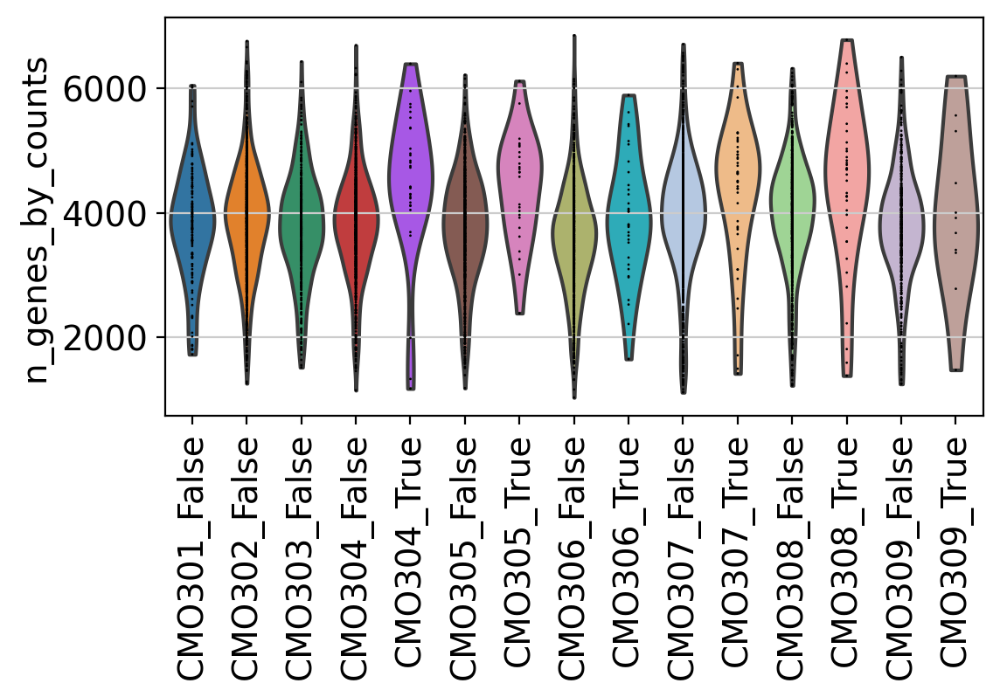

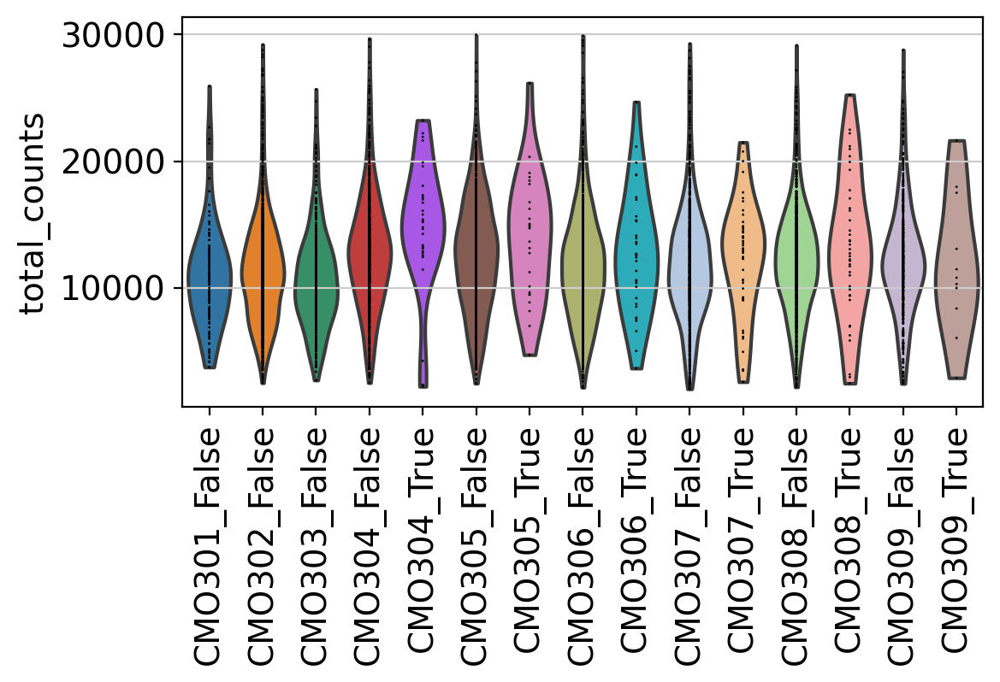

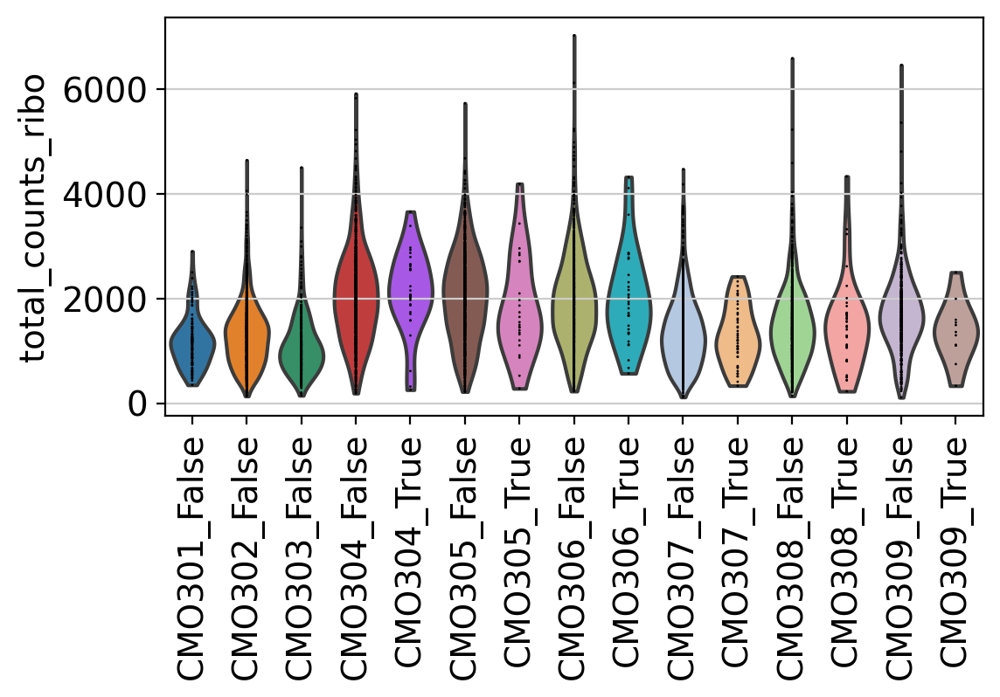

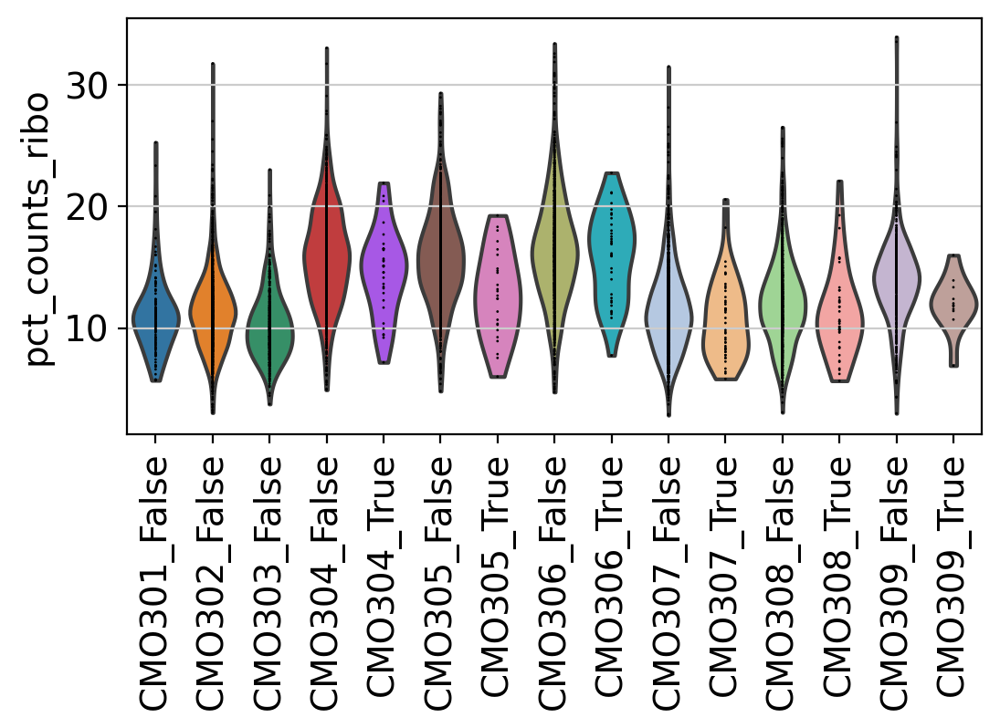

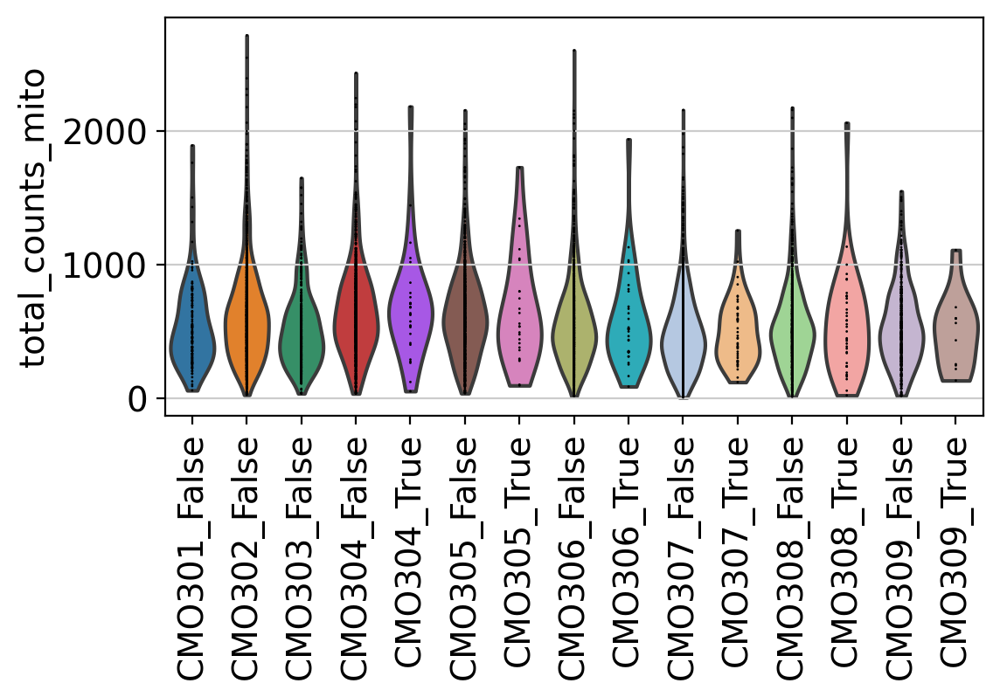

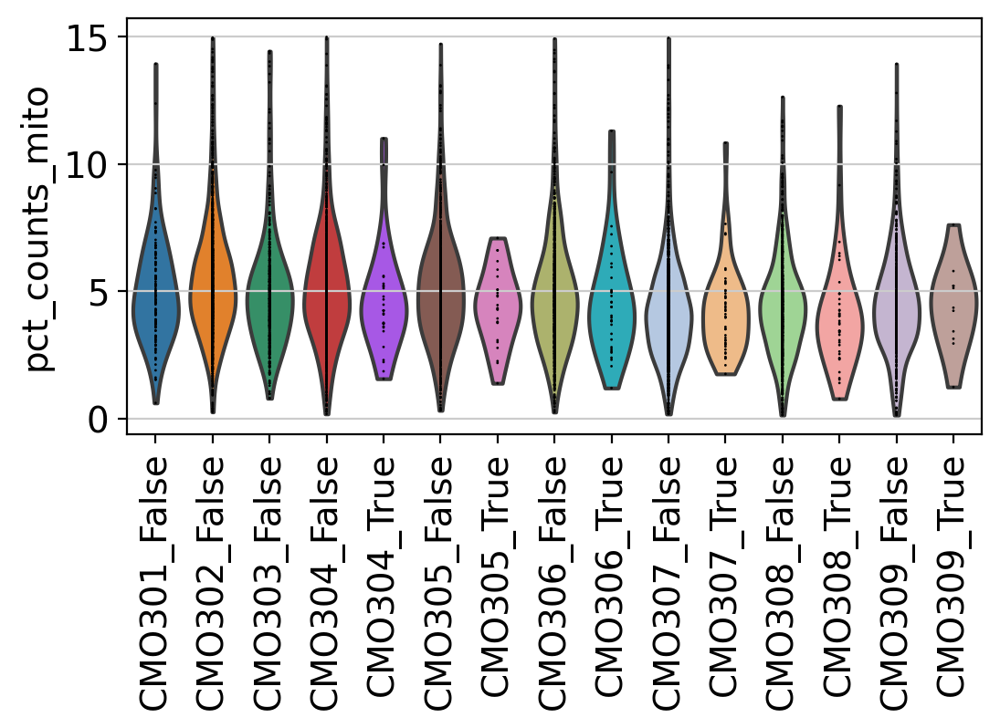

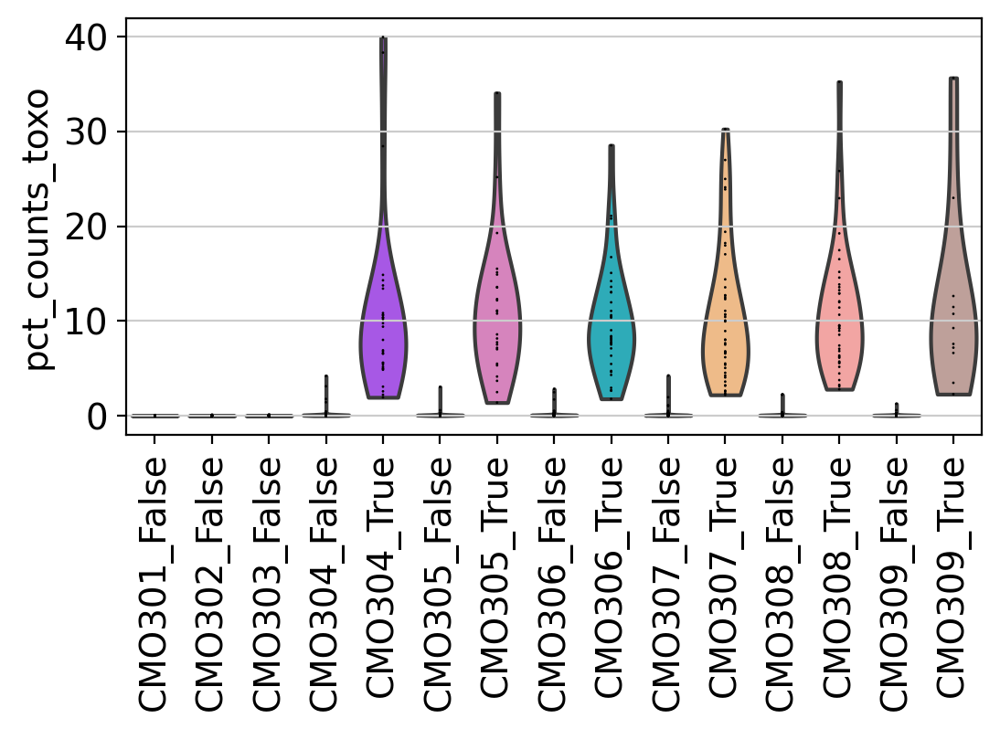

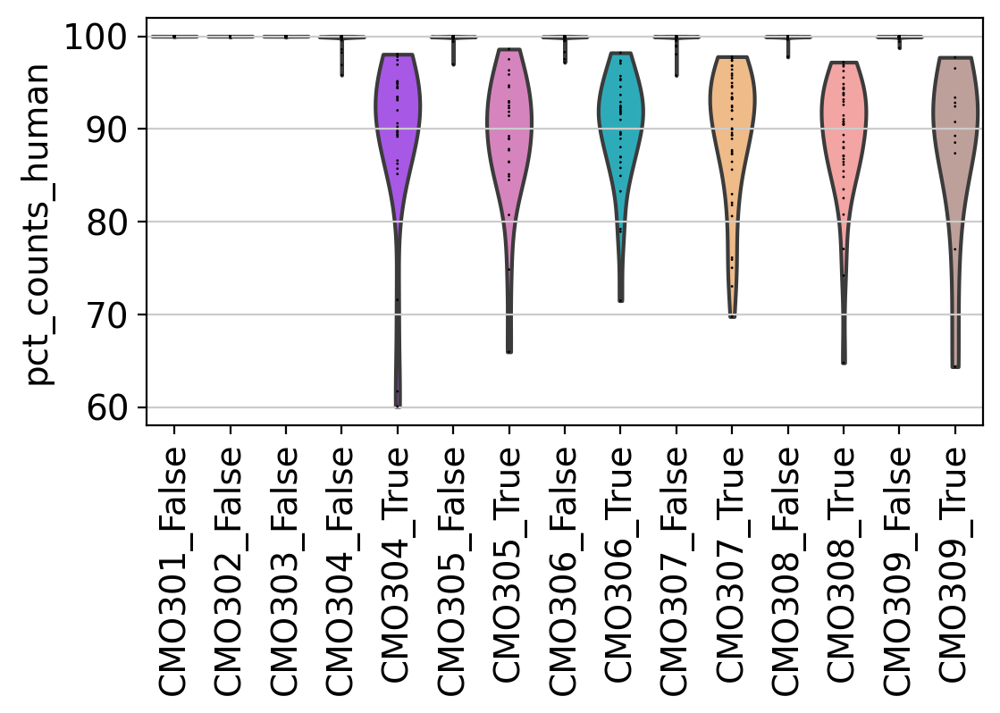

In [152]:
fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['n_genes_by_counts'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['total_counts'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['total_counts_ribo'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['pct_counts_ribo'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['total_counts_mito'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['pct_counts_mito'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['pct_counts_toxo'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()

fig, ax = plt.subplots(figsize=(6,3))
sc.pl.violin(N_clusters, ['pct_counts_human'], groupby='sample_infect', multi_panel=True, jitter=False, log=False, rotation=90., ax=ax)
plt.show()


# Saving

## Save adata

In [153]:
results_file = os.path.join(data_folder, "annotated_dataset_human.h5ad")
onlyhuman.write(results_file)

... storing 'sample_infect' as categorical


In [154]:
results_file = os.path.join(data_folder, "annotated_dataset_both.h5ad")
adata.write(results_file)

## Timestamp finished computations

In [155]:
print(datetime.now())

2022-11-24 15:09:35.967710


## Save python and html version of notebook

In [156]:
nb_fname = ipynbname.name()
nb_fname

'01-filtering-and-annotation'

In [157]:
%%bash -s "$nb_fname"
sleep 120
jupyter nbconvert "$1".ipynb --to="python" --ClearOutputPreprocessor.enabled=True
jupyter nbconvert "$1".ipynb --to="html"

[NbConvertApp] Converting notebook 01-filtering-and-annotation.ipynb to python
[NbConvertApp] Writing 29581 bytes to 01-filtering-and-annotation.py
[NbConvertApp] Converting notebook 01-filtering-and-annotation.ipynb to html
[NbConvertApp] Writing 43717968 bytes to 01-filtering-and-annotation.html
